# T cells 35 Days post CRISPRoff silencing
# Replica 2B

# Pipeline to Extract and Analyze mC profiles from BAM files and look at Forward & Reverse strands


In [1]:
from datetime import datetime

def current_time():
    """Returns the current date and time as a formatted string."""
    return datetime.now().strftime("%Y-%m-%d %H:%M:%S") 

if __name__ == "__main__":
    print("Current Date and Time:", current_time())

Current Date and Time: 2025-11-10 03:28:27


Save subsets of reads

In [2]:
import sys
from pathlib import Path
from datetime import datetime

from matplotlib import pyplot as plt 
import seaborn as sns
import pandas as pd
import numpy as np
# import time
# import shap


# Add the folder containing 'my_functions.py' to sys.path
sys.path.append("/home/michalula/code/epiCausality/epiCode/utils/") # str(Path(__file__).parent / 'utils'))

# Import the module or specific functions
# from /home/michalula/code/epiCausality/epiCode/utils/funcs_extract_mC_profiles_from_BAMs.py
# from funcs_extract_mC_profiles_from_BAMs import system_info, extract_from_bam
from funcs_extract_mC_profiles_from_BAMs import (
    system_info,
    get_reference_sequence,
    create_output_directory,
    extract_from_bam,
    process_extracted_reads,
    visualize_data,
    create_padded_reads,
    plot_padded_reads,
    save_padded_reads,
    remove_low_methylated_reads,
    process_extracted_reads_no_fully_unmethylated,
    create_padded_reads_no_fully_unmethylated,
    subset_BAM_by_read_IDs,
    bam_to_sam,
    plot_bam_quality_metrics
    # main,
)
from funcs_analize_forward_reverse_extracted_mC_reads import analize_forward_reverse_CGs_pipeline

from funcs_check_quality_bams import get_read_info_by_index, get_read_info_by_name

modkit found with expected version 0.2.4


In [3]:
system_info()
date_today = datetime.today().strftime('%Y-%m-%d')
ref_genome_path = Path('/home/michalula/data/ref_genomes/t2t_v2_0/up_chm13v2.0.fasta')
reg_genome_version = "T2Tv2_0"
region_chr = 'chr1'

# 6500bps: EXACT cutting region  
# chr1:206,583,334-206,589,873
region_start = 206583334    + 20
region_end = 206589874      - 20 
# CD55 TSS start: chr1:206586828-206606065 (+)
# (before TSS: 3474, after TSS: 3026 bps)

region_str = region_chr + ":" + str(region_start) + "-" + str(region_end) #'chr1:206586162-206586192'
region_length = region_end - region_start
print("region_length", region_length)


motifs=['CG,0']
ref_seq_list = get_reference_sequence(ref_genome_path, region_chr, region_start, region_end)

print('region_chr', region_chr)
print('region_start', region_start)
print('region_end', region_end)
print(f'{region_chr}:{region_start}-{region_end}') 

System: Linux
Release: 6.8.0-85-generic
Version: #85~22.04.1-Ubuntu SMP PREEMPT_DYNAMIC Fri Sep 19 16:18:59 UTC 2
Processor: x86_64
Python version: 3.11.9 | packaged by conda-forge | (main, Apr 19 2024, 18:36:13) [GCC 12.3.0]
region_length 6500
GTCATTGTATGGTTCCTGGGATAAGAGTAAGAACCGTGGTCCCTTGCTCTGTCAAAATCATAAACCTATTTTCTTTGTATTTTGACTTAATTACATAAGCTTGTTTTGGATTGGAAGGTCTATAGAGACTATTTTAGTGCCAAATGCTATTTAATCAATGCAGAAATAAGCCCTTGAGAGGTGCAGTGACTCAGCTGAGGACACACTGATAGTTTCTGGTAGATAAGTATGAAGCCTTGGAACTACTTCTCATATCATAAGCCCCTGGGTTCCCAAATCACCTCCCCAAGTACCTAATTCATCATCCTCTGCATACAAGAAATTTTTGCTCATTCCAATAAAAAGAATGTAGTACGGCAGGACAGGAGAAGTACAGGTTTTGGAATCAAACTAGGTTTAGATTCTGACCTGGTCGCTAGTTAGTGCATGGGCTTTGGTAAACAGCCTCTCAGCCTGTTTCCTTGTCTGCAAAATATGGATAGTTATCTTCACTTCATGAAGTTGTGTTGGTGAAATGGTATAATGTGTATAAAGCAACTGGAACACAACAAATGAGGCCATTTATTTAAAATAATCTTTAGTAAGTTATAAATTCACATATTTGCTTTTTTCTGAGGAATGCTTAGATTTTATCATAGATCTCTTTTCTAAATTGAGTAAATACATAGTGGATTTCTTTGTTTCCTTCCCCTCAGAATGTTGAAATTTGGCTGATTGTAACTATTACTTAAGACTCTATCCAGTAATTGTTCGTA

# Day 35 T celss post CRISPRoff - replica 2B


In [4]:
replica = "2B"
replica

'2B'

In [5]:
day_num = 35 #
day_num

35

In [11]:
editor_type = "CRISPRoff"  #
cell_type = "Tcells"

experiment_condition = f"replica{replica}_Day{day_num}_{editor_type}_{cell_type}_postEP_R9minion"  # {editor_type}
print("experiment_condition:", experiment_condition)
# original_bam_path = "/home/michalula/data/cas9_nanopore/data/20250908_nCATs_T_CRoff_Day_35/5mCG/to_t2t_v2_0/sort_align_t2t_v2_0_trim_20250908_Day35_CROFF_Tcells_2Libraries_Minion_R9.dna_r9.4.1_e8_sup@v3.3.5mCG.bam"
# "/home/michalula/data/cas9_nanopore/data/20250721_nCATs_Tcells_CROFF_Day28/mergered_outputs/5mCG/to_t2t_v2_0/sort_align_t2t_v2_0_trim_20250721_Day28_CROFF_T_cells_minion_merged_flowcells_output.dna_r9.4.1_e8_sup@v3.3.5mCG.bam"
folder_path = "//home/michalula/data/cas9_nanopore/data/20251028_D35_repl2B_CRoff_Tcel_1368ngDNA/all_2libs/5mCG/to_t2t_v2_0/"
bam_name = "sort_align_t2t_v2_0_trim_2libs_20251028_D35_repl2B_CRoff_Tcel.dna_r9.4.1_e8_sup@v3.3.5mCG.bam"

original_bam_path = folder_path + bam_name
original_bam_path

experiment_condition: replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion


'//home/michalula/data/cas9_nanopore/data/20251028_D35_repl2B_CRoff_Tcel_1368ngDNA/all_2libs/5mCG/to_t2t_v2_0/sort_align_t2t_v2_0_trim_2libs_20251028_D35_repl2B_CRoff_Tcel.dna_r9.4.1_e8_sup@v3.3.5mCG.bam'

# Full run

experiment_name =  replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.7_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60
Region length: 6500
No specified number of cores requested. 24 available on machine, allocating all.
Modification threshold of 0.7 will be treated as coming from range 0-1.


          | Step 1: Identify motif locations in up_chm13v2.0.fasta   0% | 00:00

          | Step 2: Parse regions in sort_align_t2t_v2_0_trim_2libs_20251028_D35_repl2B_CRoff_Tcel.dna_r9.4.1_…

          |    0%

          | Transferring 444 from reads.CG,0.txt into reads.combined_basemods.h5, new size 444   0% | 00:00<?

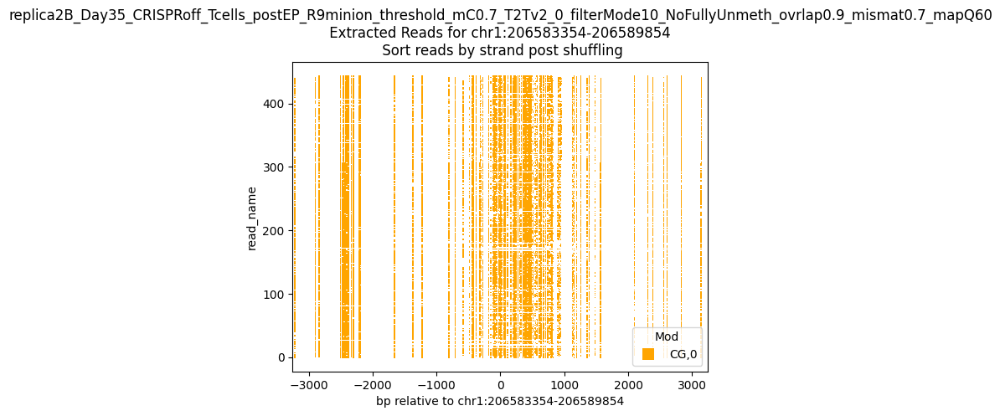

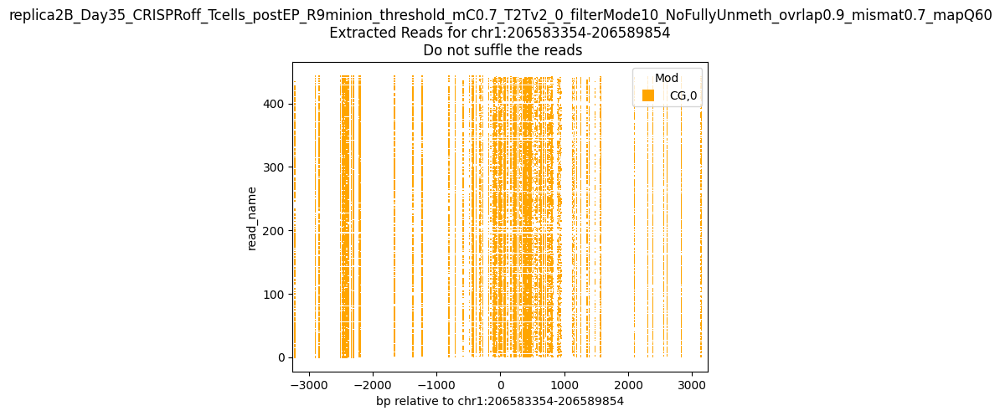

Found read coordinates: 444 reads
Unique read names with methylation: 439
In function count_indels_and_mismatches: Processing region is chr1:206583354-206589854
In function count_indels_and_mismatches: Region length is 6500
Found 265 reads with full coverage
Reads with methylation data: 439
Overlap between full coverage and methylation: 263
After full coverage filtering: 263 reads with methylation data
Subset BAM written to: dimelo_v2_output/pre_filtered_ROI_reads_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.7_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam
Index written to: dimelo_v2_output/pre_filtered_ROI_reads_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.7_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam.bai
Pre Filtered BAM with reads that have some covarage of the ROI written to 
 pre_filtered_ROI_reads_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.7_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.

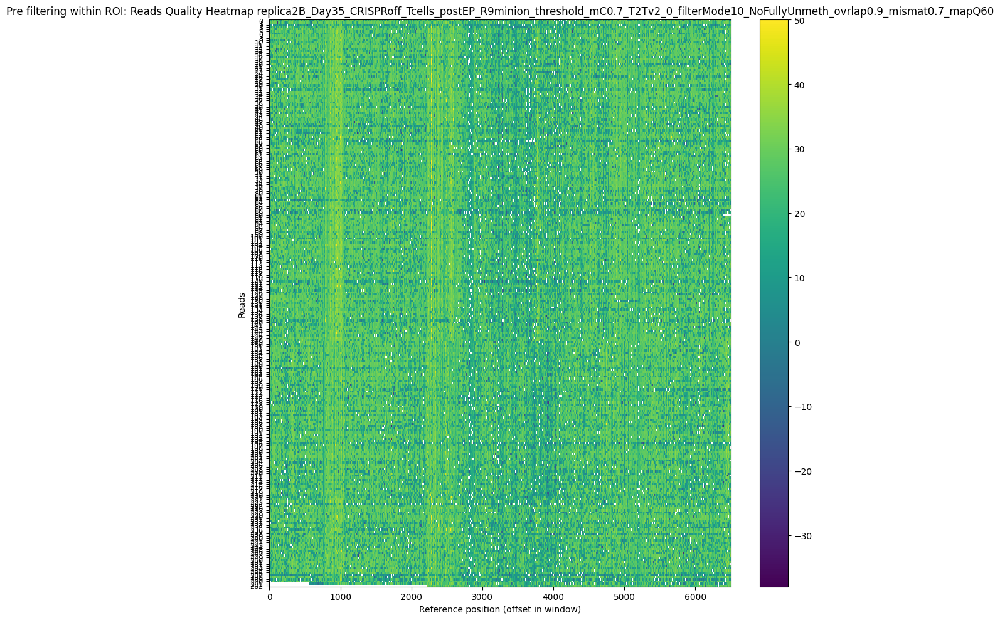

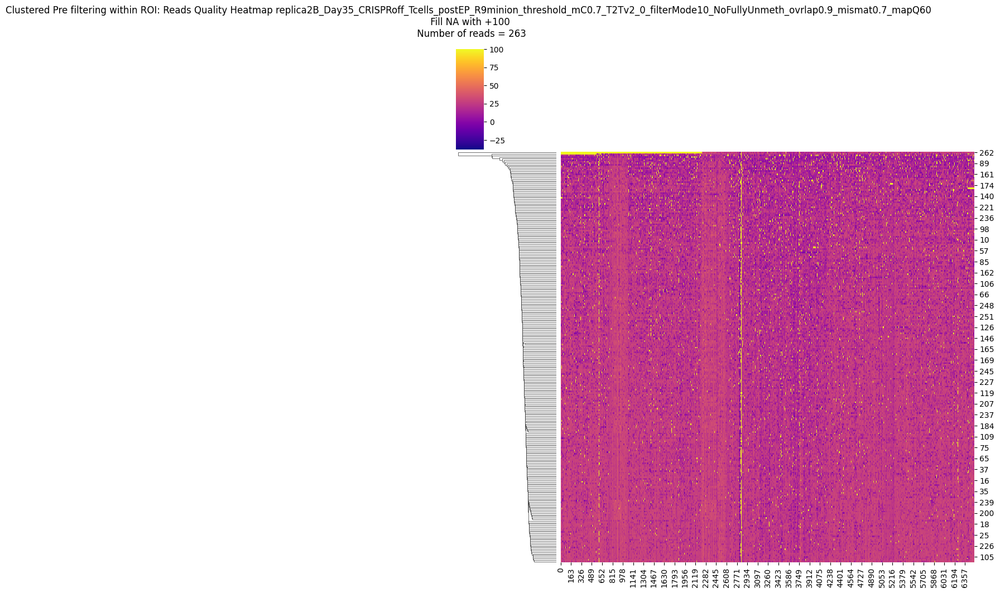

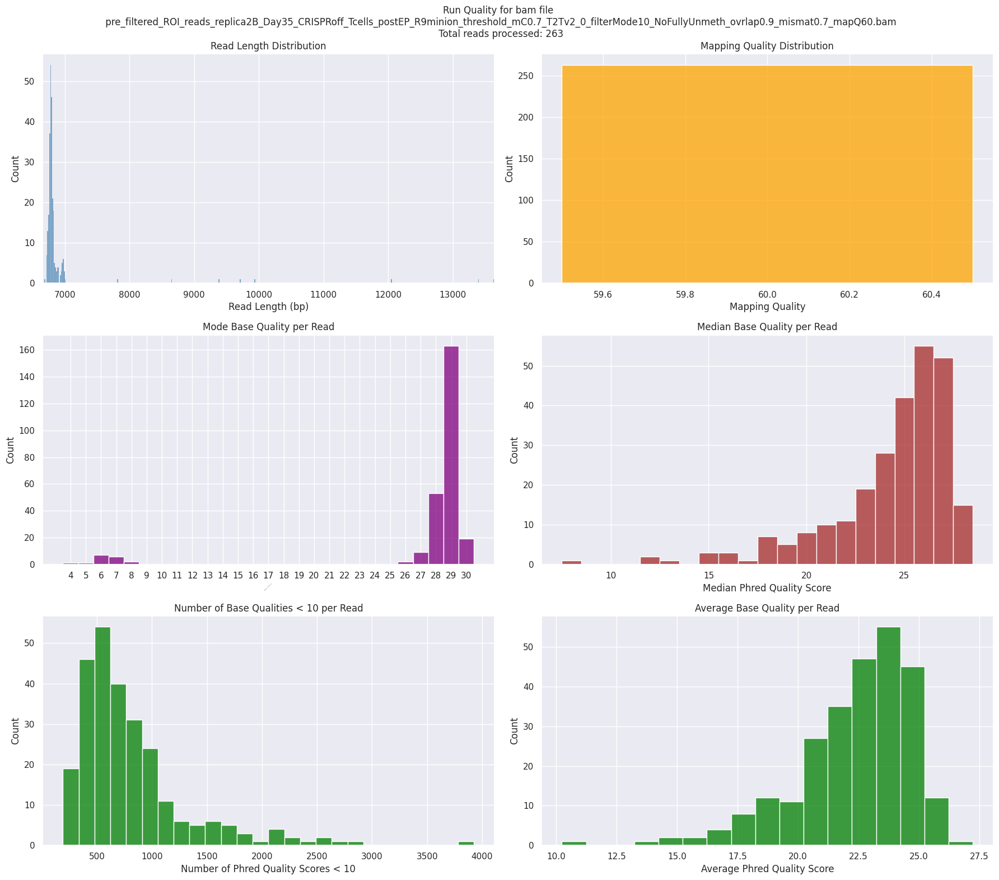

Total reads processed: 263
After removing reads with <90.0% threshold_fraction_overlap_aligned: 260 reads with methylation data
After removing reads with >70.0% threshold_fraction_mismatches: 260 reads with methylation data
After removing reads with >60 threshold_mapping_qualities: 260 reads with methylation data
After removing reads with >10 threshold_mode_base_qualities: 245 reads with methylation data
Final result: 17884 reads with methylation information out of 444 total reads
Subset BAM written to: dimelo_v2_output/filtered_reads_overlap_MORE_than_0.9_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.7_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam
Index written to: dimelo_v2_output/filtered_reads_overlap_MORE_than_0.9_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.7_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam.bai
Filtered BAM with reads that have mC and base overlap > 0.9 written to 
 dimelo_v2_output/filtered_

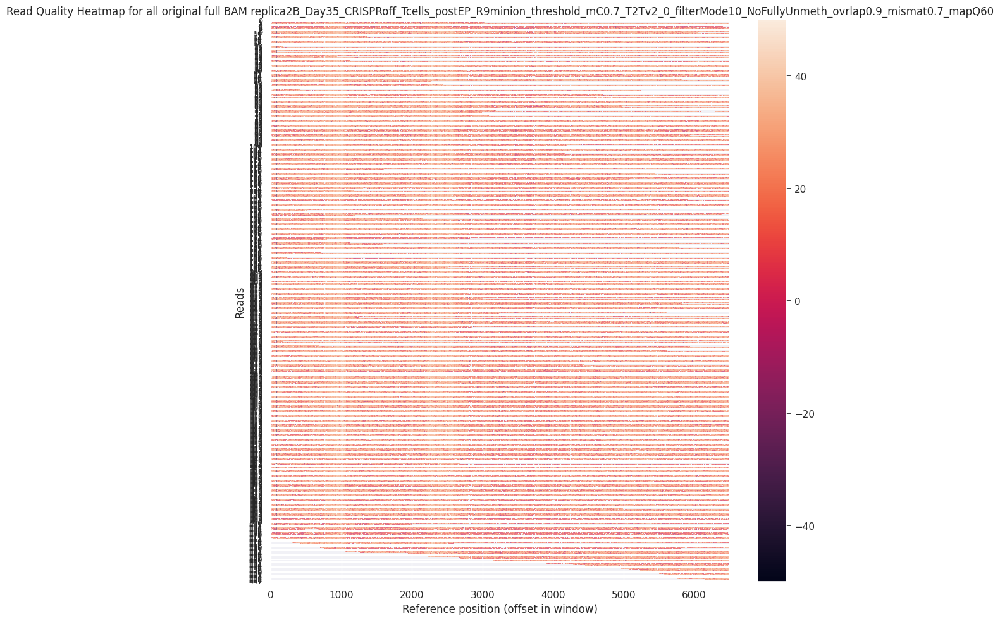

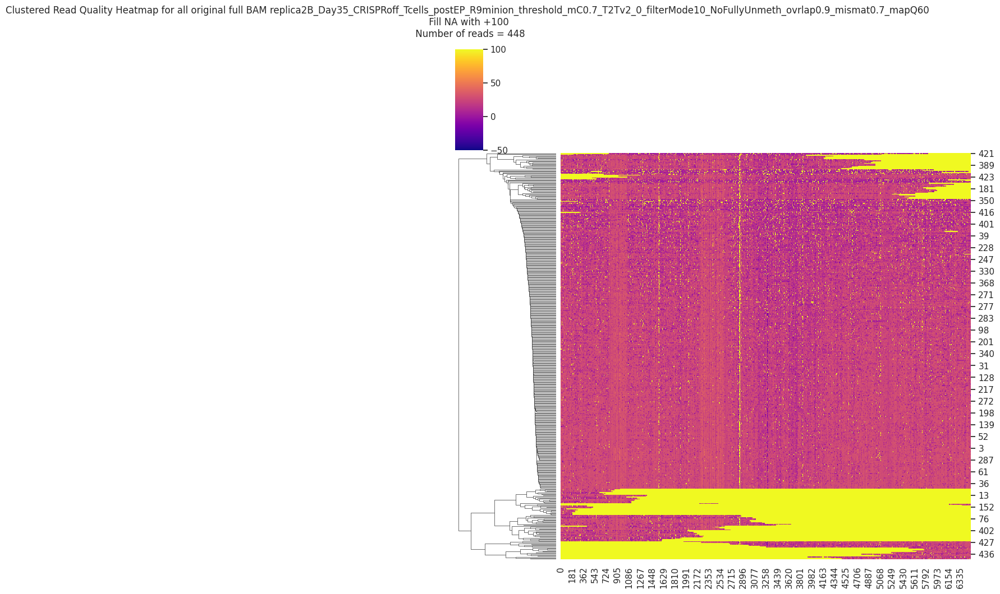

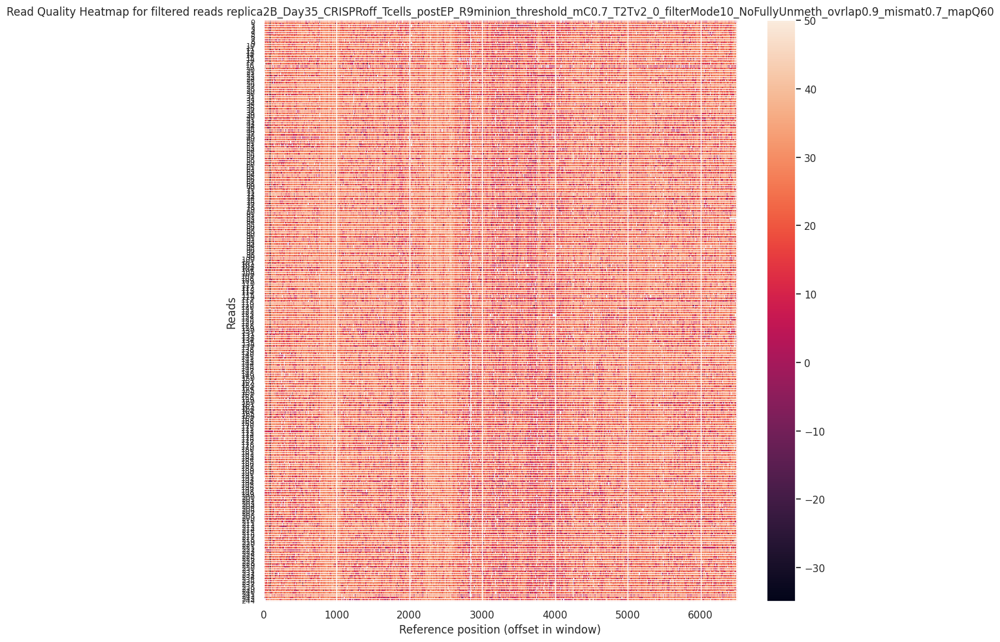

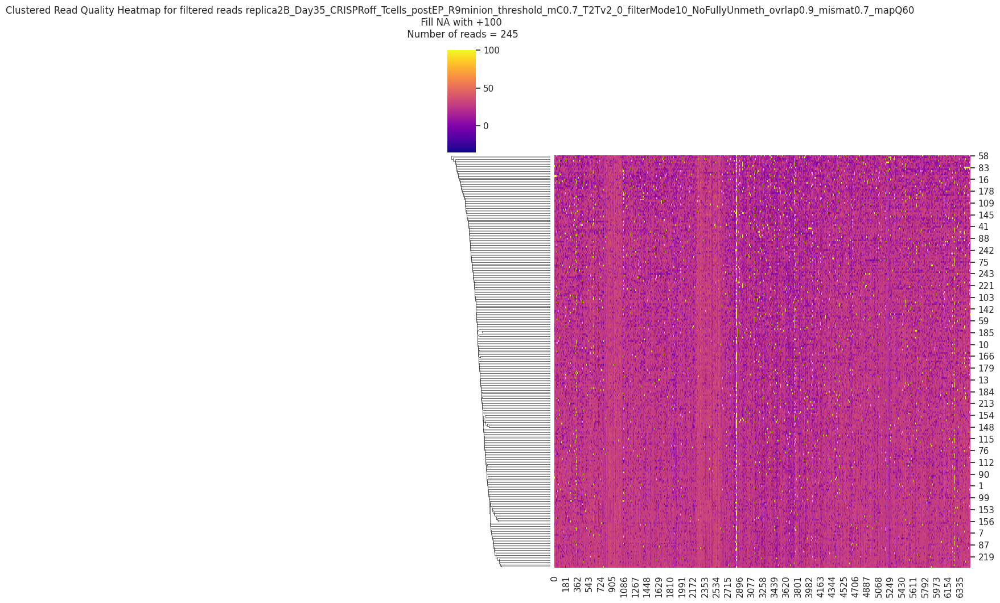

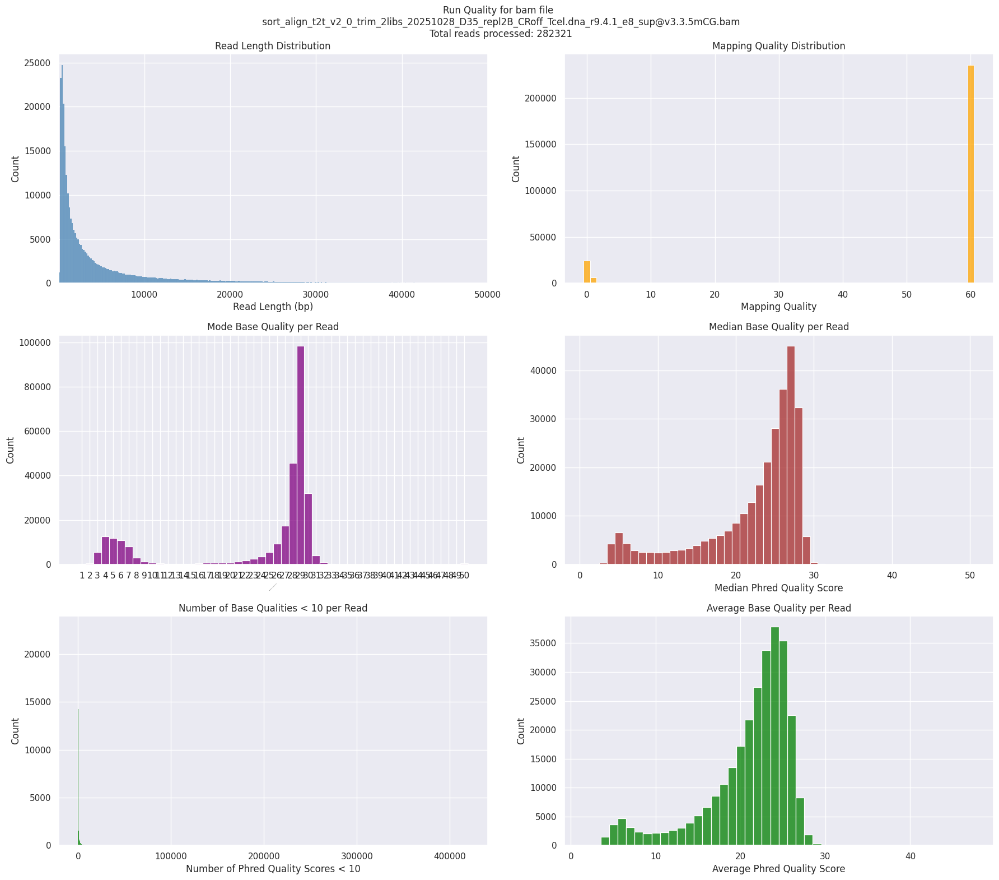

Total reads processed: 282321


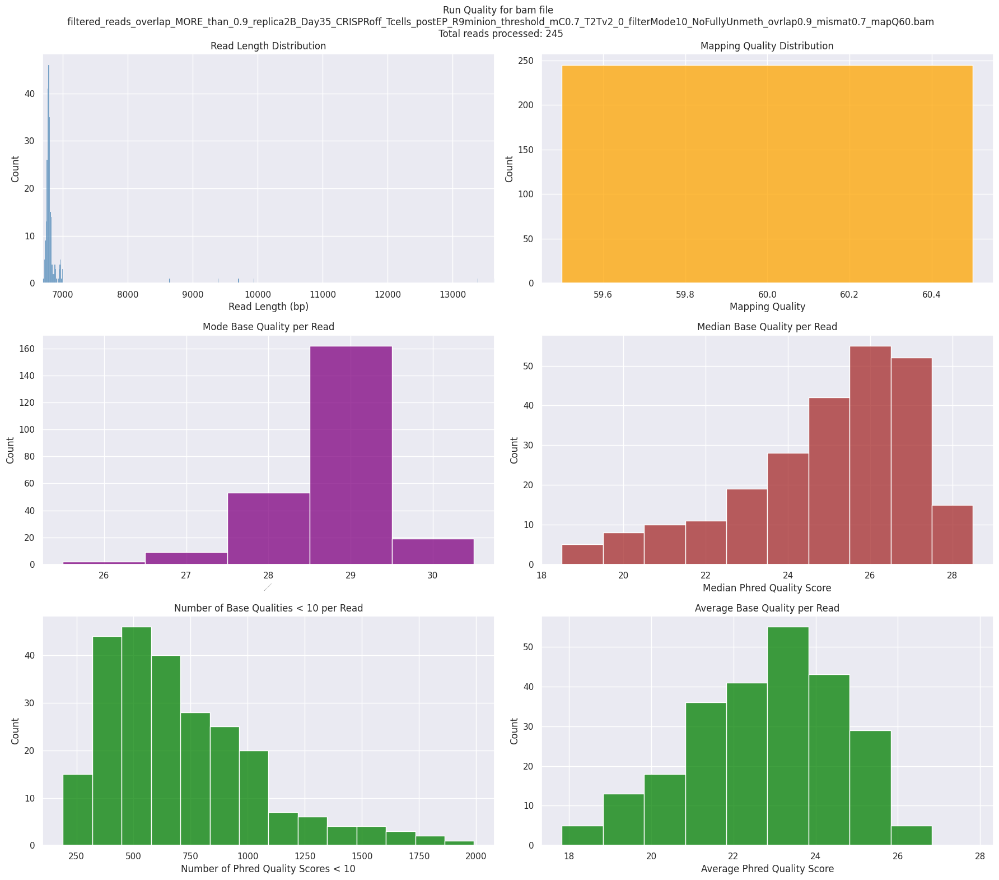

Total reads processed: 245


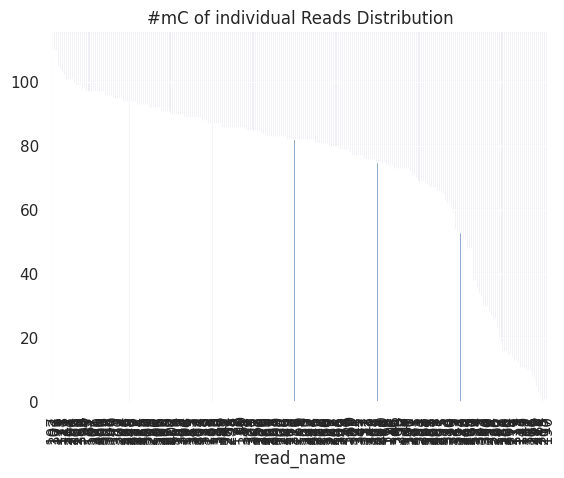

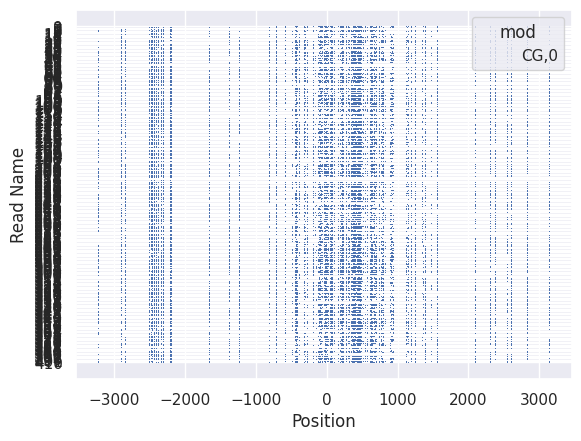

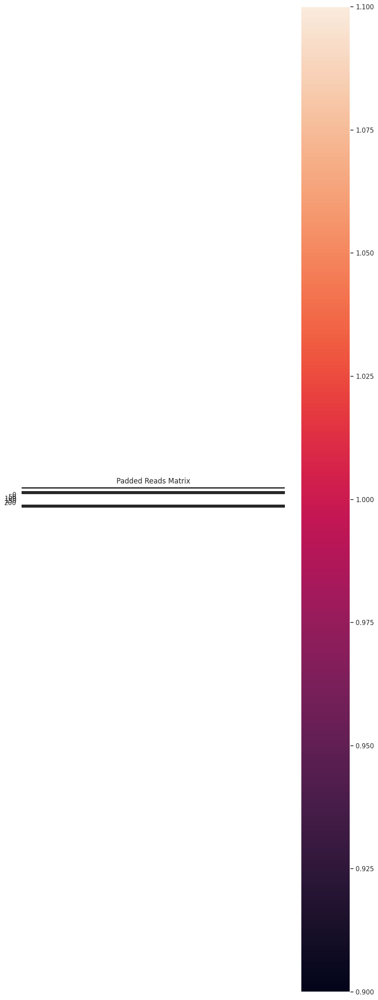

Padded reads saved to padded_reads_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.7_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60_mCthresh0.7_T2Tv2_0_chr1:206583354-206589854_2025-11-10.npy
Padded reads loaded successfully.


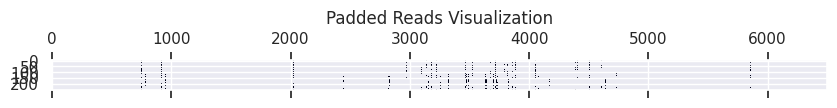

Visualization completed.
Region length: 6500
GTCATTGTATGGTTCCTGGGATAAGAGTAAGAACCGTGGTCCCTTGCTCTGTCAAAATCATAAACCTATTTTCTTTGTATTTTGACTTAATTACATAAGCTTGTTTTGGATTGGAAGGTCTATAGAGACTATTTTAGTGCCAAATGCTATTTAATCAATGCAGAAATAAGCCCTTGAGAGGTGCAGTGACTCAGCTGAGGACACACTGATAGTTTCTGGTAGATAAGTATGAAGCCTTGGAACTACTTCTCATATCATAAGCCCCTGGGTTCCCAAATCACCTCCCCAAGTACCTAATTCATCATCCTCTGCATACAAGAAATTTTTGCTCATTCCAATAAAAAGAATGTAGTACGGCAGGACAGGAGAAGTACAGGTTTTGGAATCAAACTAGGTTTAGATTCTGACCTGGTCGCTAGTTAGTGCATGGGCTTTGGTAAACAGCCTCTCAGCCTGTTTCCTTGTCTGCAAAATATGGATAGTTATCTTCACTTCATGAAGTTGTGTTGGTGAAATGGTATAATGTGTATAAAGCAACTGGAACACAACAAATGAGGCCATTTATTTAAAATAATCTTTAGTAAGTTATAAATTCACATATTTGCTTTTTTCTGAGGAATGCTTAGATTTTATCATAGATCTCTTTTCTAAATTGAGTAAATACATAGTGGATTTCTTTGTTTCCTTCCCCTCAGAATGTTGAAATTTGGCTGATTGTAACTATTACTTAAGACTCTATCCAGTAATTGTTCGTAAAATTTCTTTTCTTTTTTTTTTTTTGAGACGGAGTTTTGCTCTCGTCCCCCAGGCTGGAGTGCAATGGCGCGATCTTGGCTCACTGCAACCTCCGCCTCCCAGGTTCAAGTGATTCTCCCGCCTCAGCCTCCCAAGTAGCTGGGATTACAGGCACCTGCCACAACGCCCAGCCAATTTTTGTATTTTTAGTAGAGACGGG

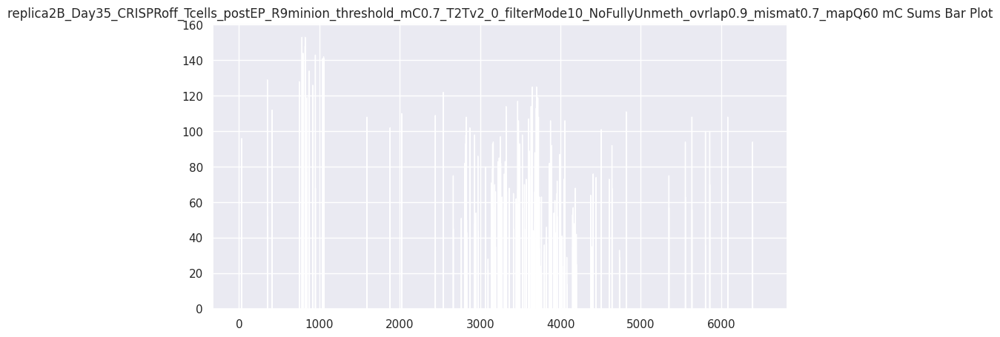

(mC_sums / len(CGs_all) = [0. 0. 0. ... 0. 0. 0.]


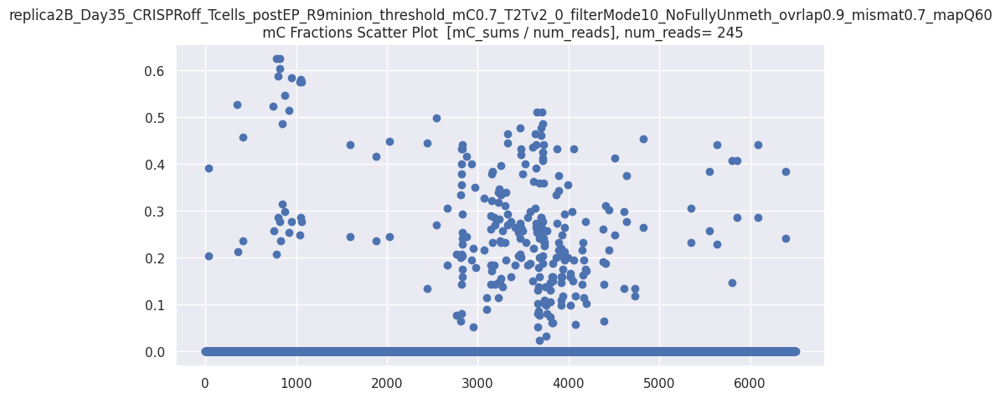

len(CGs_all) = 245
CGs_all.shape = (245, 137)
len(CGs_all_on_fwd_C_sums) = 6500
CGs_all_on_fwd_C_sums.shape = (6500,)


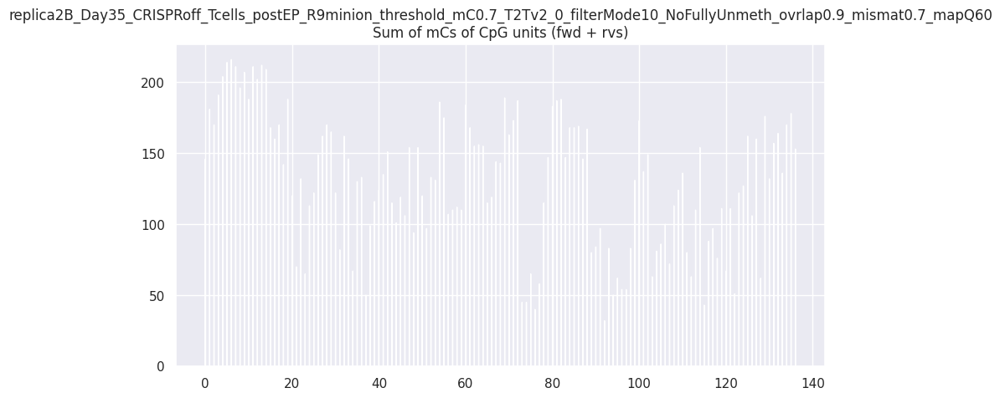

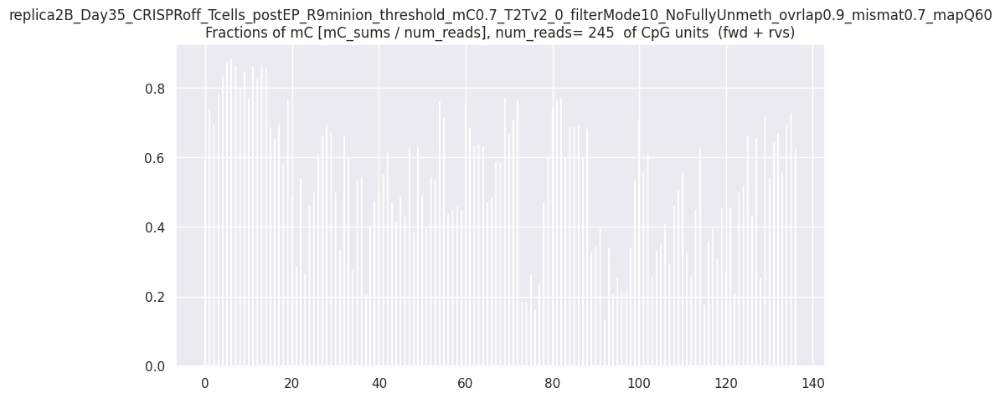

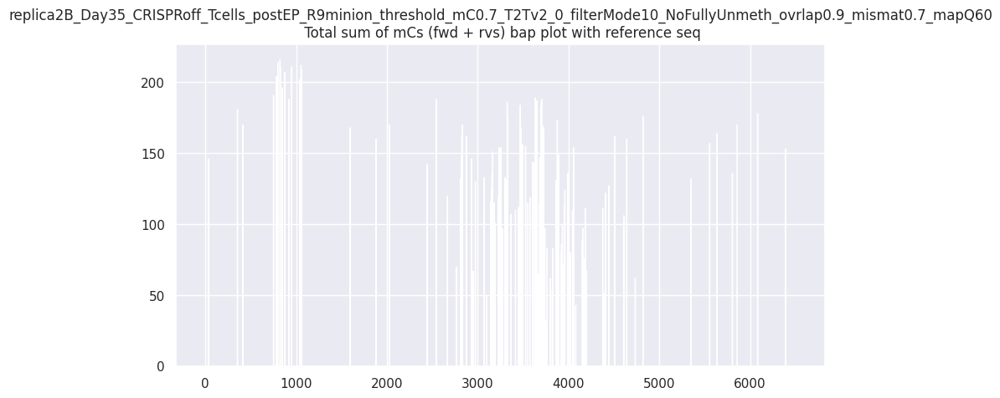

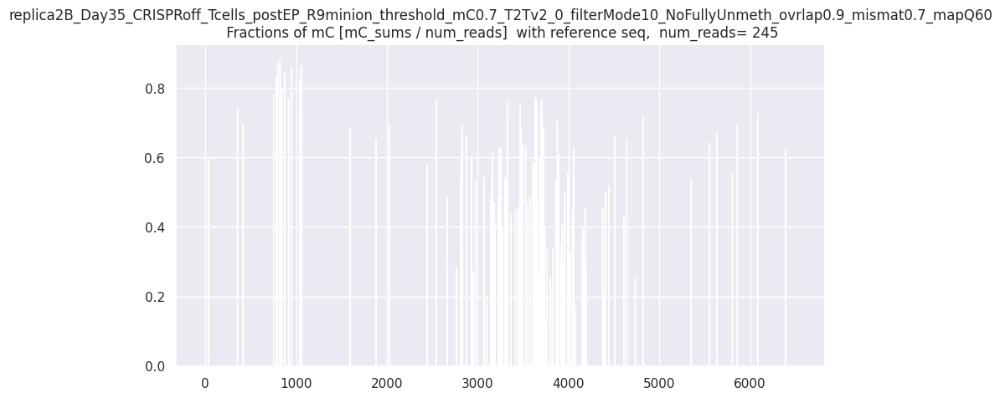

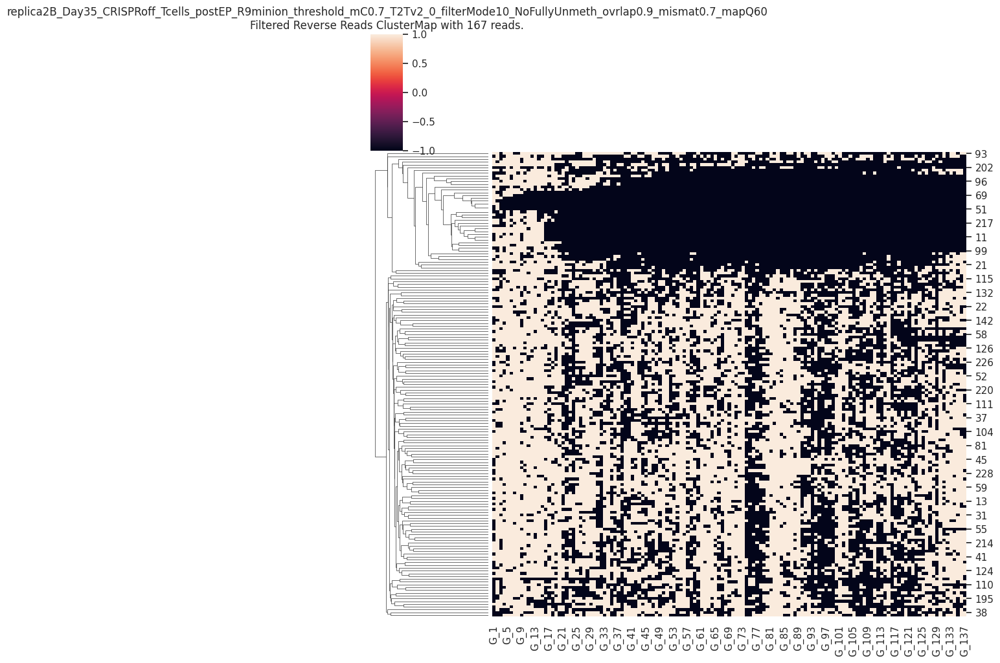

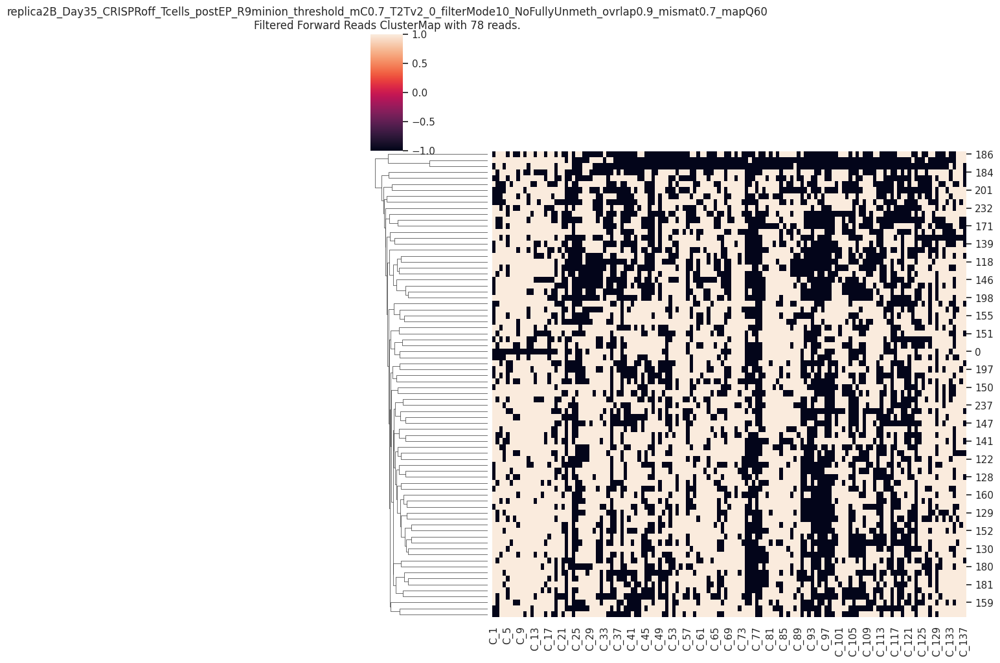

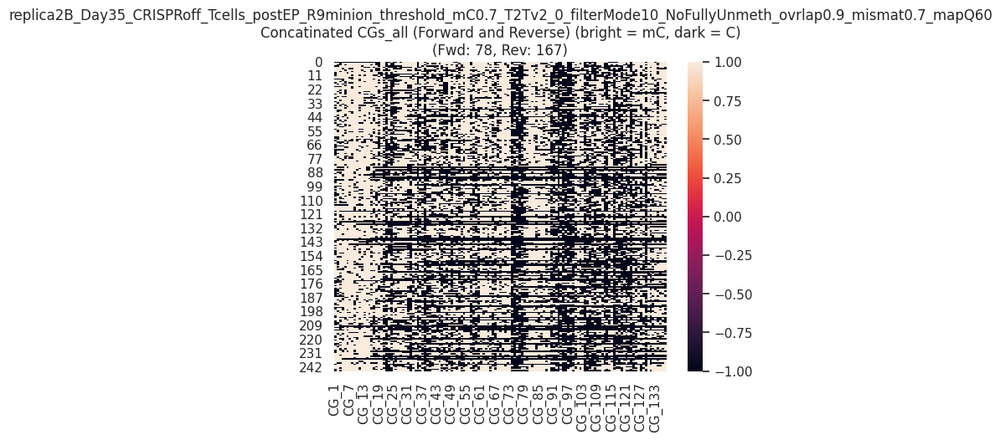

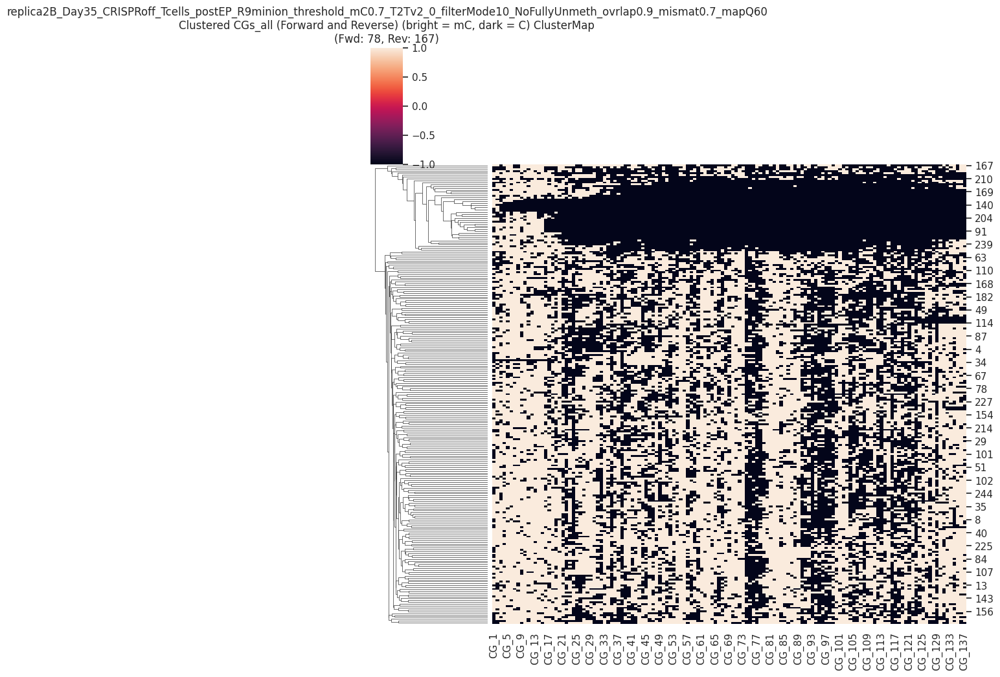

CGs_all saved as CG_137_padded_reads_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.7_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60_mCthresh0.7_T2Tv2_0_chr1:206583354-206589854_2025-11-10_units_combined_numFWD78_numRVS167.npy in dimelo_v2_output
Pipeline executed successfully (analize_forward_reverse_CGs_pipeline function)


In [12]:
threshold_mC = 0.7 # 0.995 #0.7 #  0.9 #0.99

threshold_mode_base_qualities=10
threshold_mapping_qualities=60 
# threshold_avg_base_qualities=20

threshold_fraction_overlap_aligned = 0.9 # 0.1
threshold_fraction_mismatches = 0.7 # 0.5
# indel_fraction_threshold = 1  # 0.8
# non_fraction_threshold   = 1
max_reads_plot = 3000
remove_reads_that_dont_fully_cover_region=True

# experiment_name = "day"+str(day_num)+"_unedited_Tcells_Thr"+str(threshold_mC)+"_NoFullyUnmethylated_T2Tv2"
experiment_name = f'{experiment_condition}_threshold_mC{threshold_mC}_{reg_genome_version}' + \
    "_filterMode" + str(threshold_mode_base_qualities) + \
    "_NoFullyUnmeth_ovrlap"+str(threshold_fraction_overlap_aligned)+"_mismat"+str(threshold_fraction_mismatches)+"_mapQ"+str(threshold_mapping_qualities)
# +"_avgBaseQ"+str(threshold_avg_base_qualities)

bam_path = original_bam_path #  unedit_bam_path

print('experiment_name = ', experiment_name)

save_padded_reads_name_np = f"padded_reads_{experiment_name}_mCthresh{threshold_mC}_{reg_genome_version}_{region_str}_{date_today}.npy"
output_dir = create_output_directory("./dimelo_v2_output")

extract_file, extract_regions = extract_from_bam(
    experiment_name = experiment_name,
    bam_path=bam_path,
    ref_genome_file=ref_genome_path,
    output_dir=output_dir,
    region=region_str,
    motifs=motifs,
    output_name='extracted_reads',
    threshold_mC=threshold_mC,
)
keep_full_coverage_reads_only=True

if extract_file:
    reads_df, regions_dict = process_extracted_reads(extract_file, bam_path, region_str, 
        motifs, ref_seq_list, ref_genome_path=ref_genome_path, 
        experiment_name=experiment_name, output_dir=output_dir, 
        keep_full_coverage_reads_only=keep_full_coverage_reads_only,
        threshold_fraction_overlap_aligned=threshold_fraction_overlap_aligned,
        threshold_fraction_mismatches=threshold_fraction_mismatches,
        threshold_mapping_qualities=threshold_mapping_qualities, 
        threshold_mode_base_qualities=threshold_mode_base_qualities,
        max_reads_plot=max_reads_plot,
        remove_reads_that_dont_fully_cover_region=remove_reads_that_dont_fully_cover_region)
        # threshold_avg_base_qualities=threshold_avg_base_qualities,
        # indel_fraction_threshold=indel_fraction_threshold, 
        # non_fraction_threshold=non_fraction_threshold)
        
    visualize_data(reads_df)

    padded_reads = create_padded_reads(reads_df, regions_dict, region_length)
    if padded_reads is not None:
        plot_padded_reads(padded_reads, ref_seq_list)
        save_padded_reads(padded_reads, output_dir, save_padded_reads_name_np)

# Processing and visualizing CpG units on forward and reverse strands 
try: 

    # Process pipeline
    CGs_all, C_fwd_df, G_revs_df, padded_reads_df, CG_pair_idx, CG_coordinates, CG_info_df = analize_forward_reverse_CGs_pipeline(
        experiment_name=experiment_name, save_folder_path=output_dir, 
        save_padded_reads_name_np=save_padded_reads_name_np, 
        ref_genome_file=ref_genome_path, region_chr=region_chr, region_start=region_start, region_end=region_end
    )

    print("Pipeline executed successfully (analize_forward_reverse_CGs_pipeline function)")
    # return CGs_all, C_fwd_df, G_revs_df, padded_reads_df

except Exception as e:
    print(f"Error in main pipeline (analize_forward_reverse_CGs_pipeline function): {e}")


# threshold_mC  0.995 

experiment_name =  replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60
Region length: 6500
No specified number of cores requested. 24 available on machine, allocating all.
Modification threshold of 0.995 will be treated as coming from range 0-1.


          | Step 1: Identify motif locations in up_chm13v2.0.fasta   0% | 00:00

          | Step 2: Parse regions in sort_align_t2t_v2_0_trim_2libs_20251028_D35_repl2B_CRoff_Tcel.dna_r9.4.1_…

          |    0%

          | Transferring 444 from reads.CG,0.txt into reads.combined_basemods.h5, new size 444   0% | 00:00<?

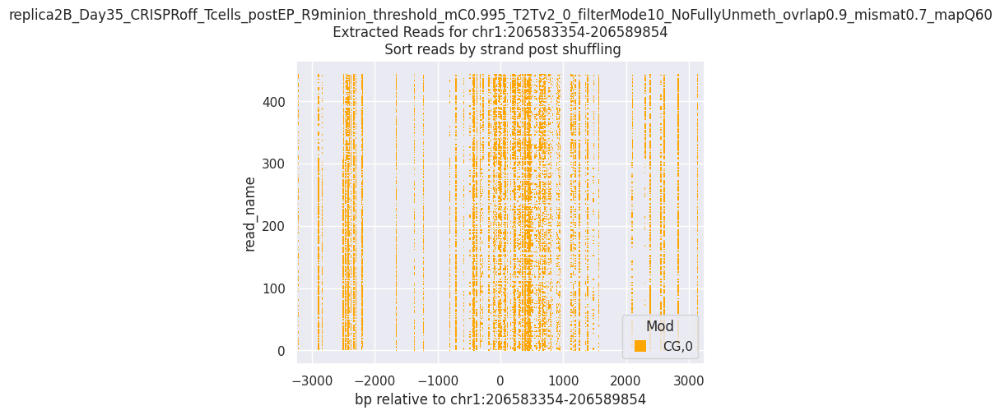

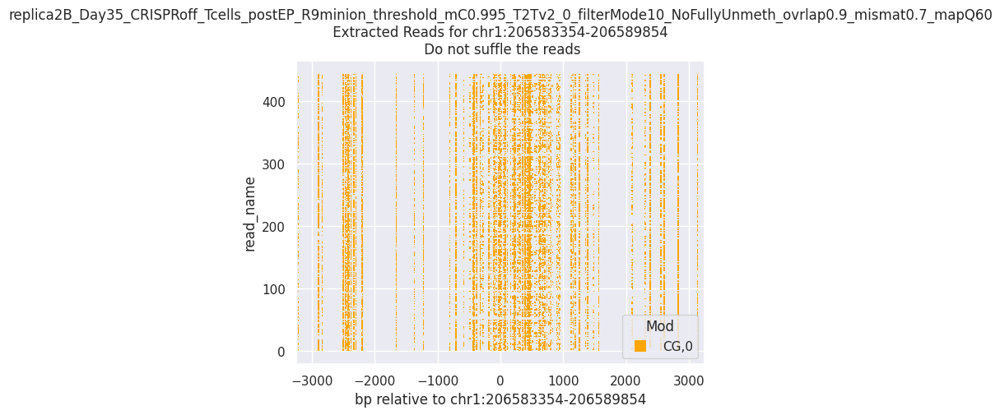

Found read coordinates: 444 reads
Unique read names with methylation: 437
In function count_indels_and_mismatches: Processing region is chr1:206583354-206589854
In function count_indels_and_mismatches: Region length is 6500
Found 265 reads with full coverage
Reads with methylation data: 437
Overlap between full coverage and methylation: 262
After full coverage filtering: 262 reads with methylation data
Subset BAM written to: dimelo_v2_output/pre_filtered_ROI_reads_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam
Index written to: dimelo_v2_output/pre_filtered_ROI_reads_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam.bai
Pre Filtered BAM with reads that have some covarage of the ROI written to 
 pre_filtered_ROI_reads_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ov

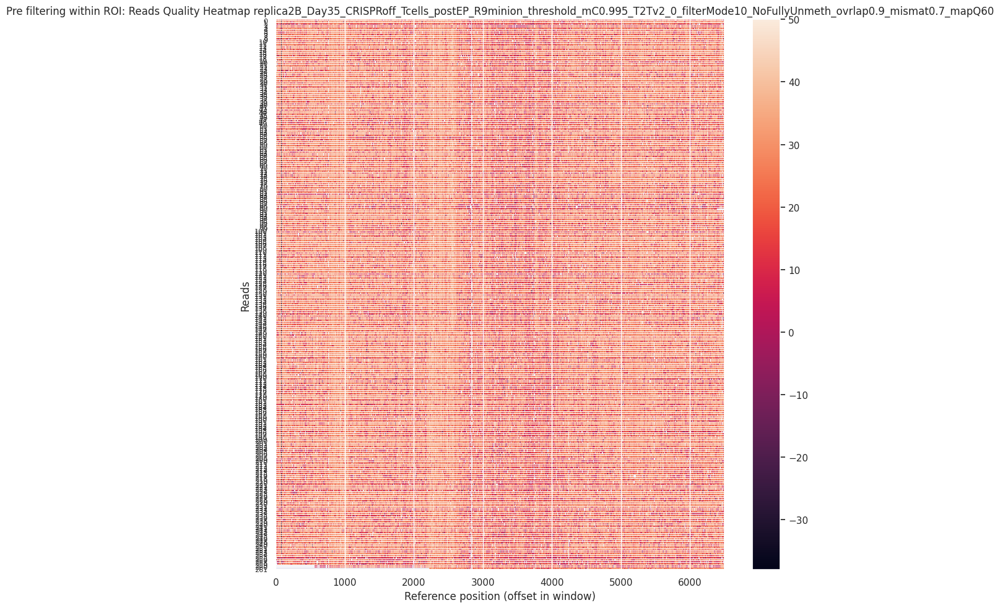

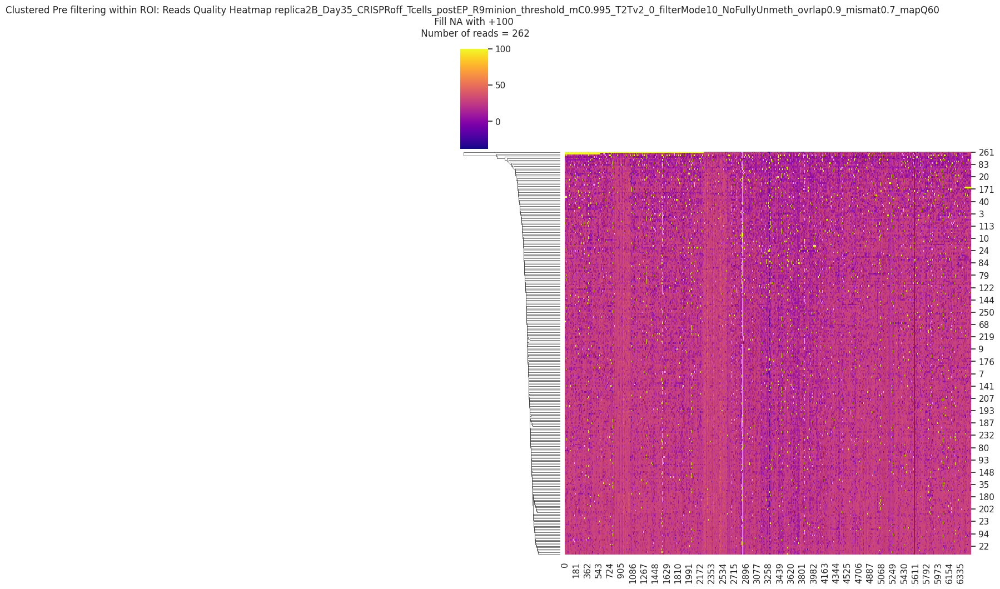

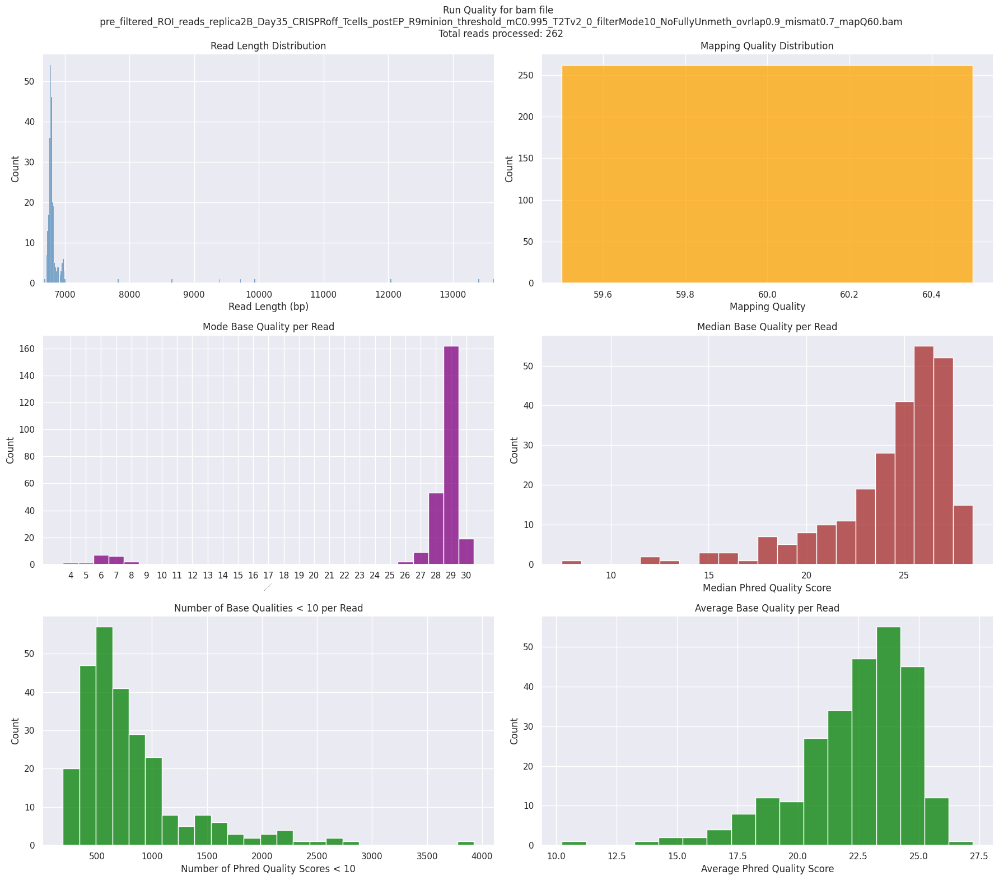

Total reads processed: 262
After removing reads with <90.0% threshold_fraction_overlap_aligned: 259 reads with methylation data
After removing reads with >70.0% threshold_fraction_mismatches: 259 reads with methylation data
After removing reads with >60 threshold_mapping_qualities: 259 reads with methylation data
After removing reads with >10 threshold_mode_base_qualities: 244 reads with methylation data
Final result: 10772 reads with methylation information out of 444 total reads
Subset BAM written to: dimelo_v2_output/filtered_reads_overlap_MORE_than_0.9_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam
Index written to: dimelo_v2_output/filtered_reads_overlap_MORE_than_0.9_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam.bai
Filtered BAM with reads that have mC and base overlap > 0.9 written to 
 dimelo_v2_output/filte

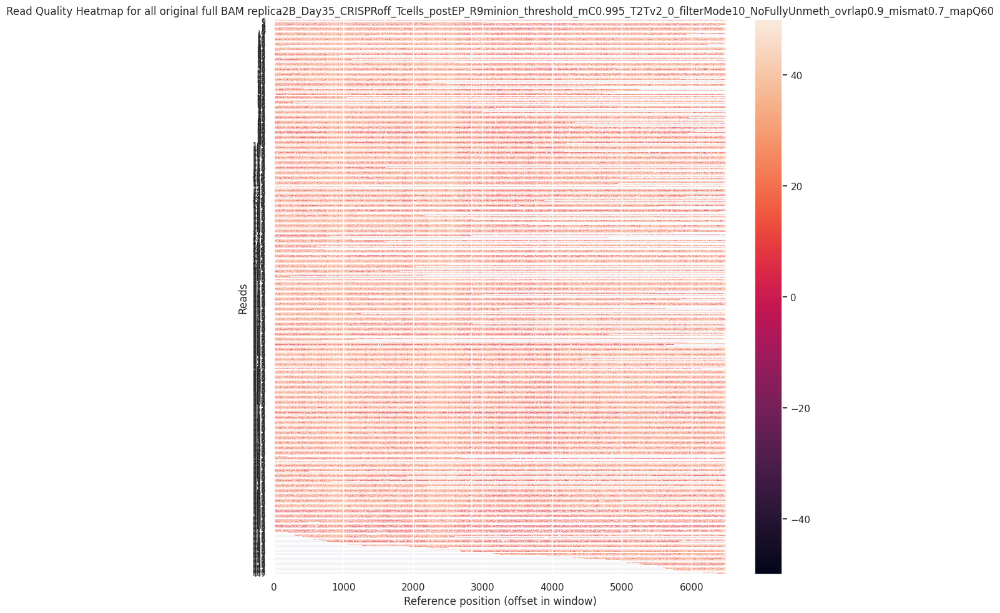

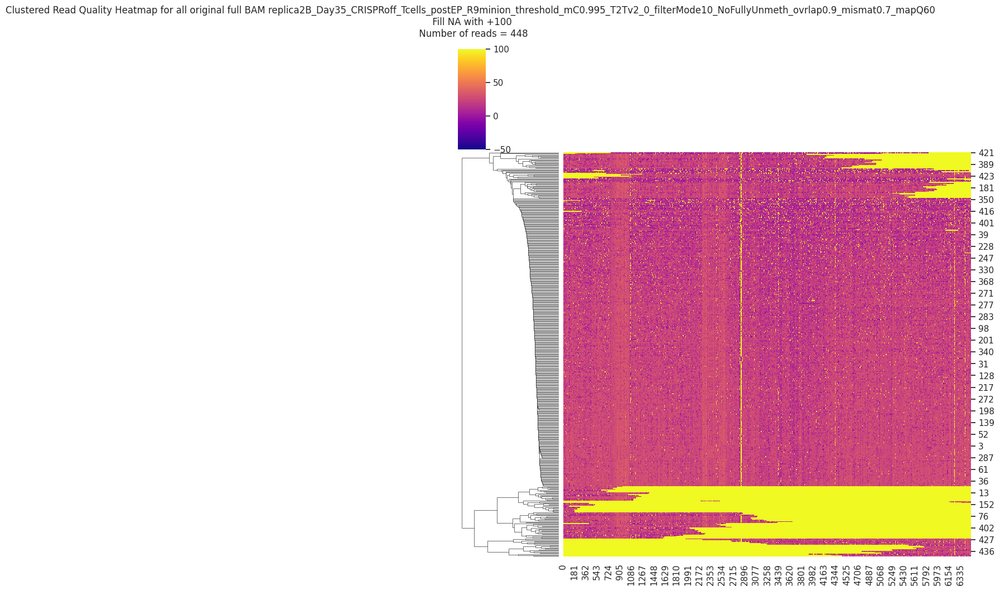

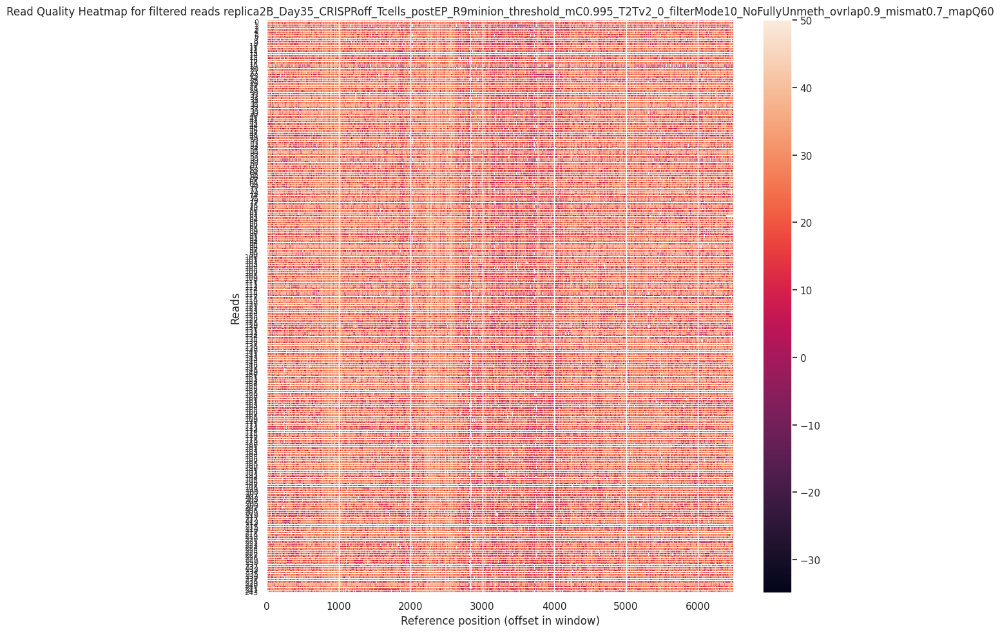

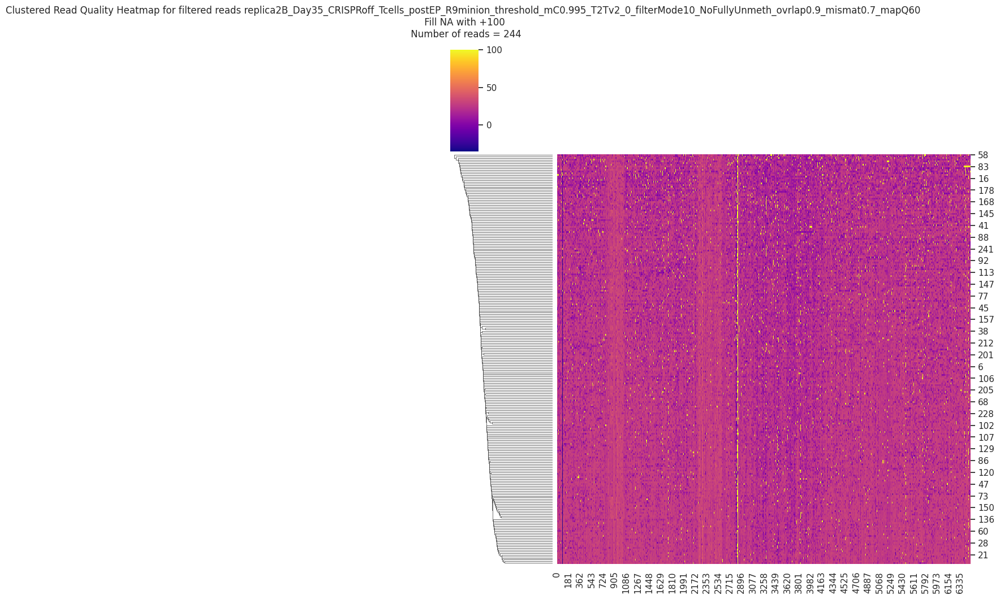

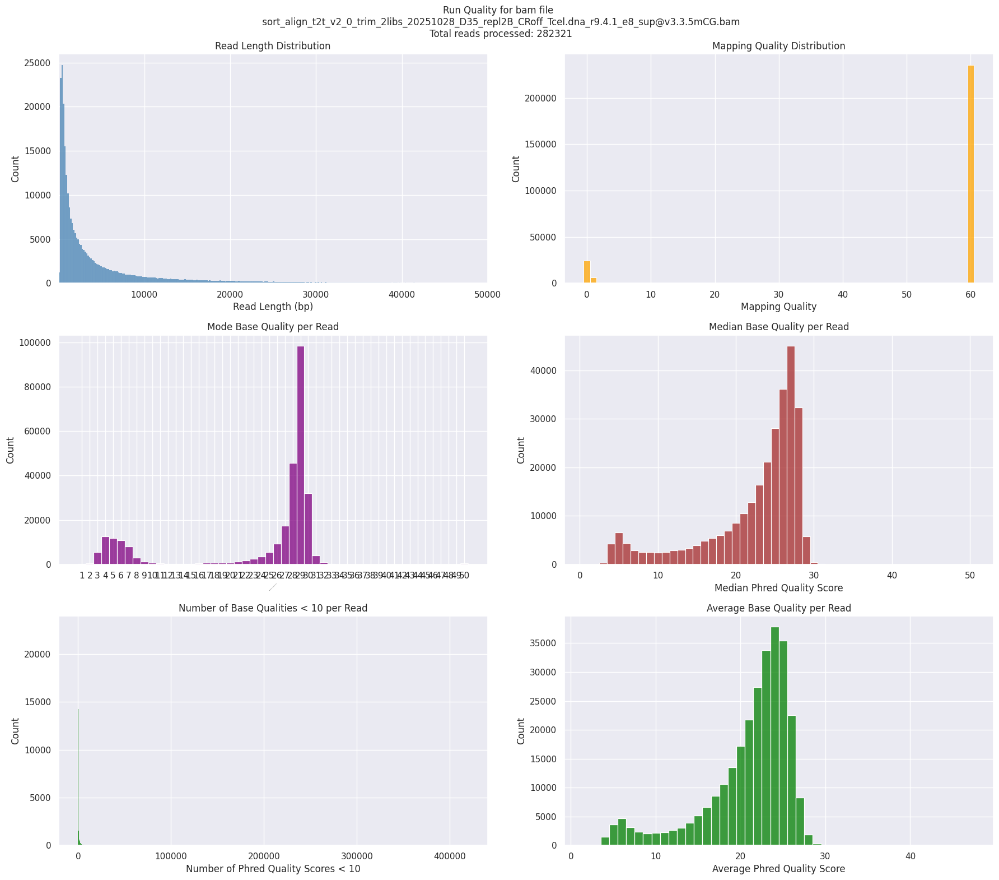

Total reads processed: 282321


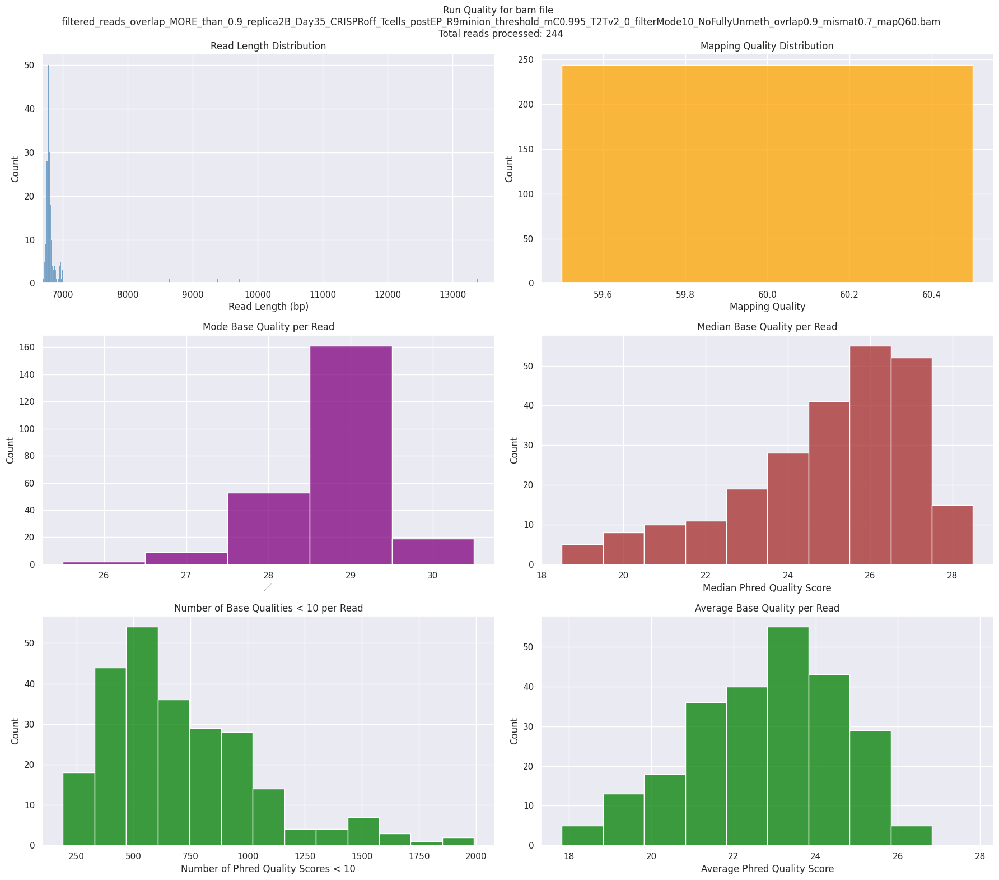

Total reads processed: 244


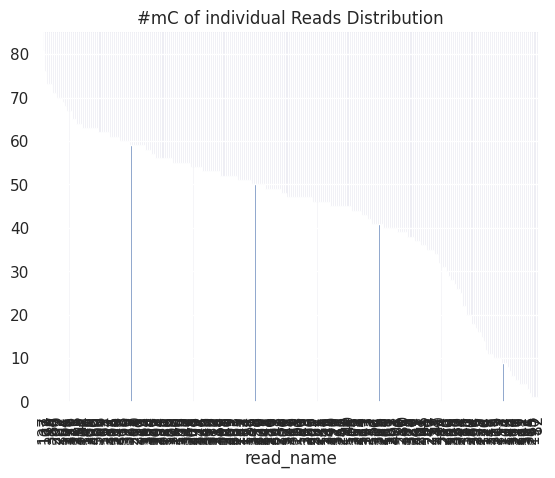

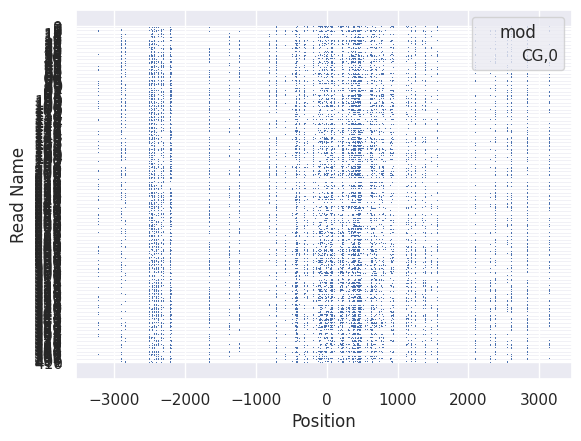

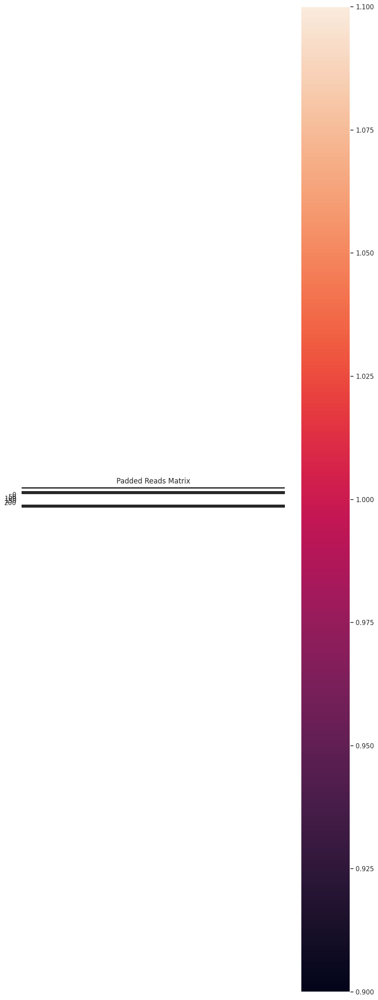

Padded reads saved to padded_reads_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60_mCthresh0.995_T2Tv2_0_chr1:206583354-206589854_2025-11-10.npy
Padded reads loaded successfully.


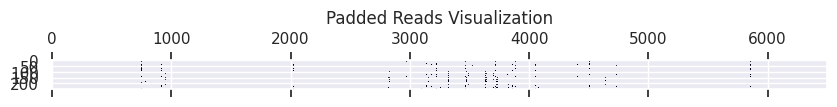

Visualization completed.
Region length: 6500
GTCATTGTATGGTTCCTGGGATAAGAGTAAGAACCGTGGTCCCTTGCTCTGTCAAAATCATAAACCTATTTTCTTTGTATTTTGACTTAATTACATAAGCTTGTTTTGGATTGGAAGGTCTATAGAGACTATTTTAGTGCCAAATGCTATTTAATCAATGCAGAAATAAGCCCTTGAGAGGTGCAGTGACTCAGCTGAGGACACACTGATAGTTTCTGGTAGATAAGTATGAAGCCTTGGAACTACTTCTCATATCATAAGCCCCTGGGTTCCCAAATCACCTCCCCAAGTACCTAATTCATCATCCTCTGCATACAAGAAATTTTTGCTCATTCCAATAAAAAGAATGTAGTACGGCAGGACAGGAGAAGTACAGGTTTTGGAATCAAACTAGGTTTAGATTCTGACCTGGTCGCTAGTTAGTGCATGGGCTTTGGTAAACAGCCTCTCAGCCTGTTTCCTTGTCTGCAAAATATGGATAGTTATCTTCACTTCATGAAGTTGTGTTGGTGAAATGGTATAATGTGTATAAAGCAACTGGAACACAACAAATGAGGCCATTTATTTAAAATAATCTTTAGTAAGTTATAAATTCACATATTTGCTTTTTTCTGAGGAATGCTTAGATTTTATCATAGATCTCTTTTCTAAATTGAGTAAATACATAGTGGATTTCTTTGTTTCCTTCCCCTCAGAATGTTGAAATTTGGCTGATTGTAACTATTACTTAAGACTCTATCCAGTAATTGTTCGTAAAATTTCTTTTCTTTTTTTTTTTTTGAGACGGAGTTTTGCTCTCGTCCCCCAGGCTGGAGTGCAATGGCGCGATCTTGGCTCACTGCAACCTCCGCCTCCCAGGTTCAAGTGATTCTCCCGCCTCAGCCTCCCAAGTAGCTGGGATTACAGGCACCTGCCACAACGCCCAGCCAATTTTTGTATTTTTAGTAGAGACGGG

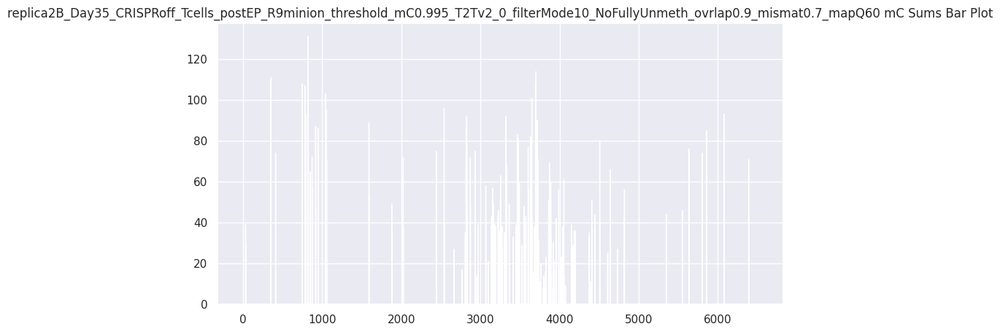

(mC_sums / len(CGs_all) = [0. 0. 0. ... 0. 0. 0.]


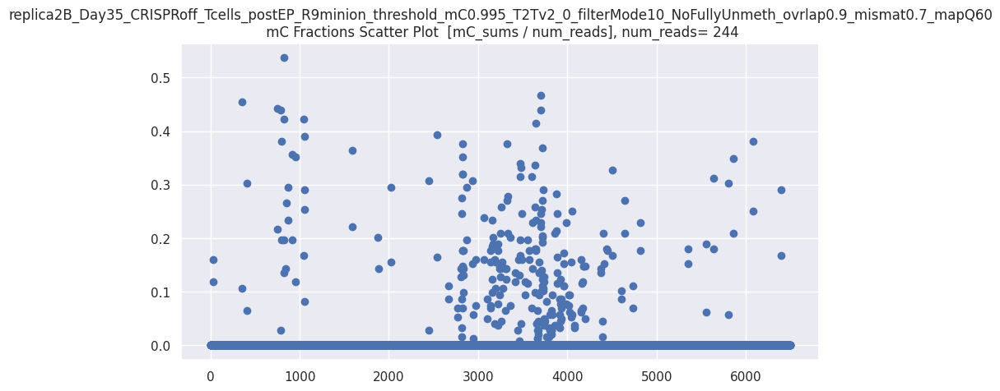

len(CGs_all) = 244
CGs_all.shape = (244, 137)
len(CGs_all_on_fwd_C_sums) = 6500
CGs_all_on_fwd_C_sums.shape = (6500,)


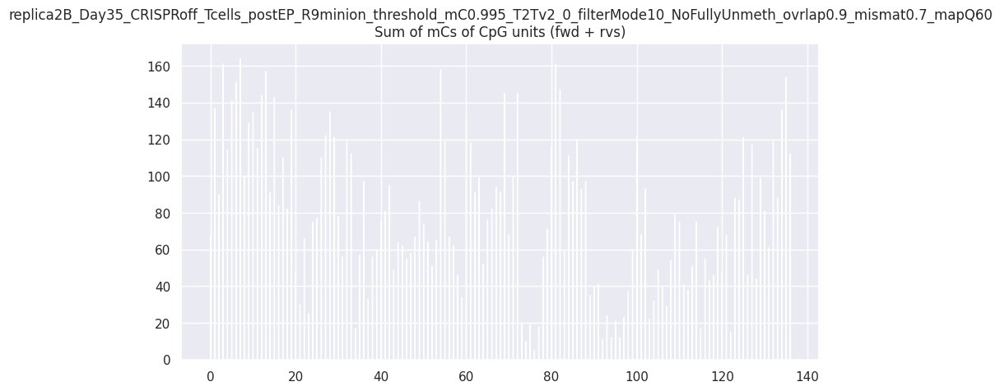

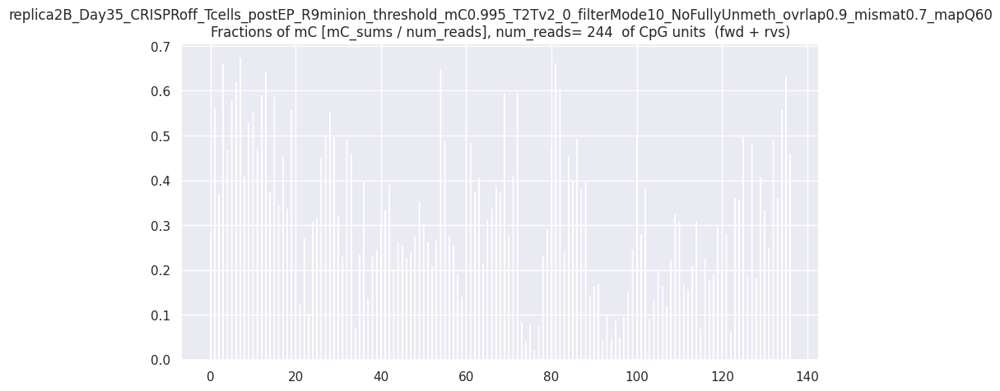

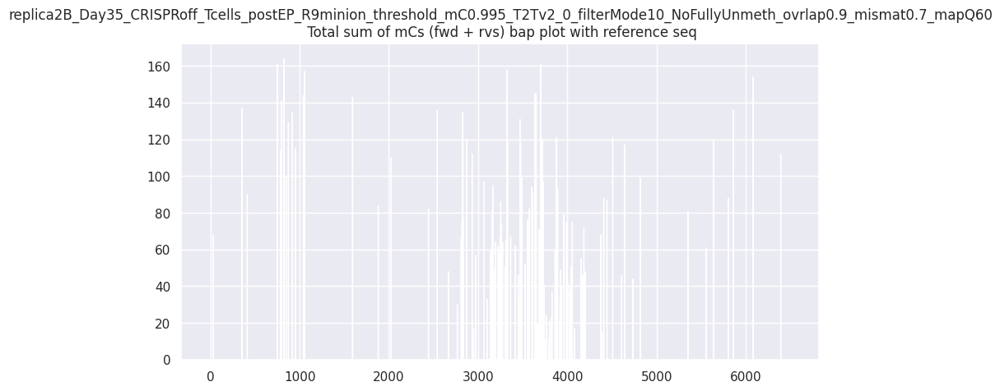

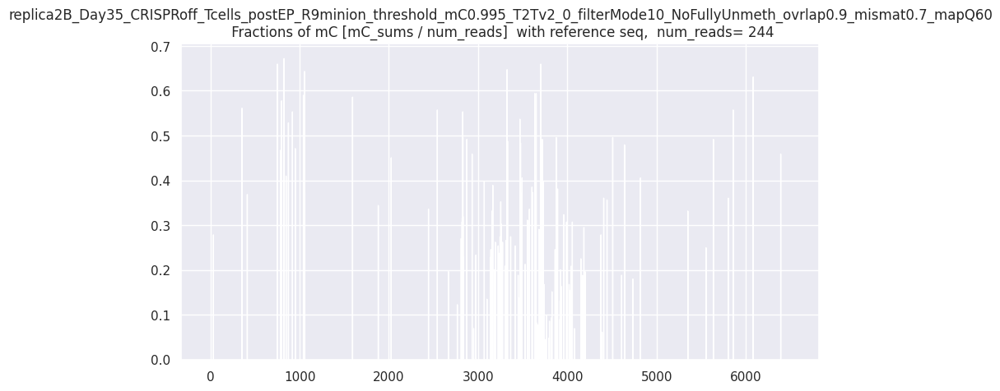

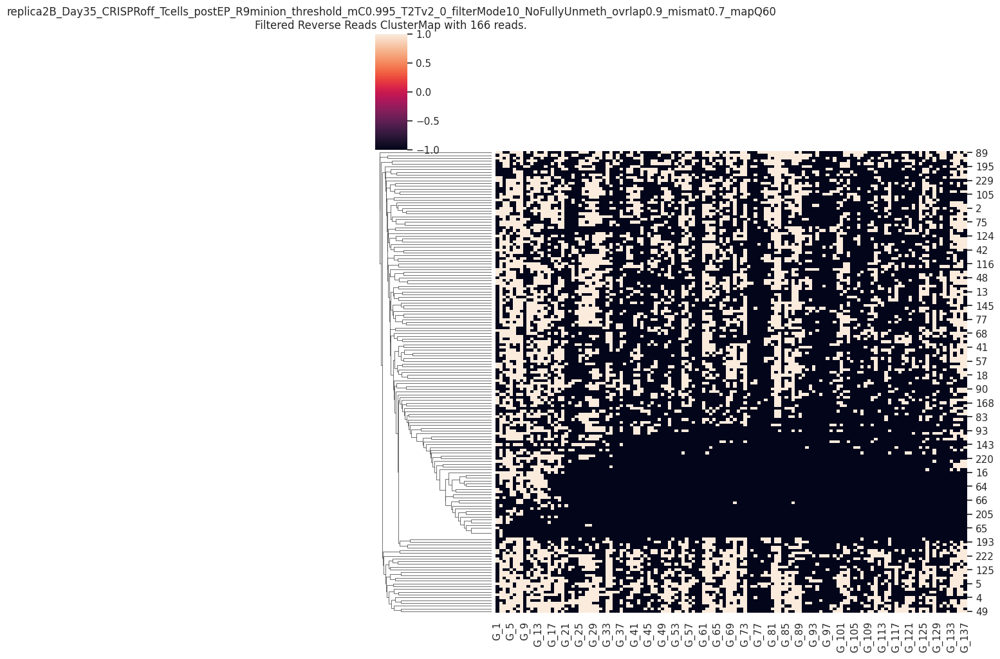

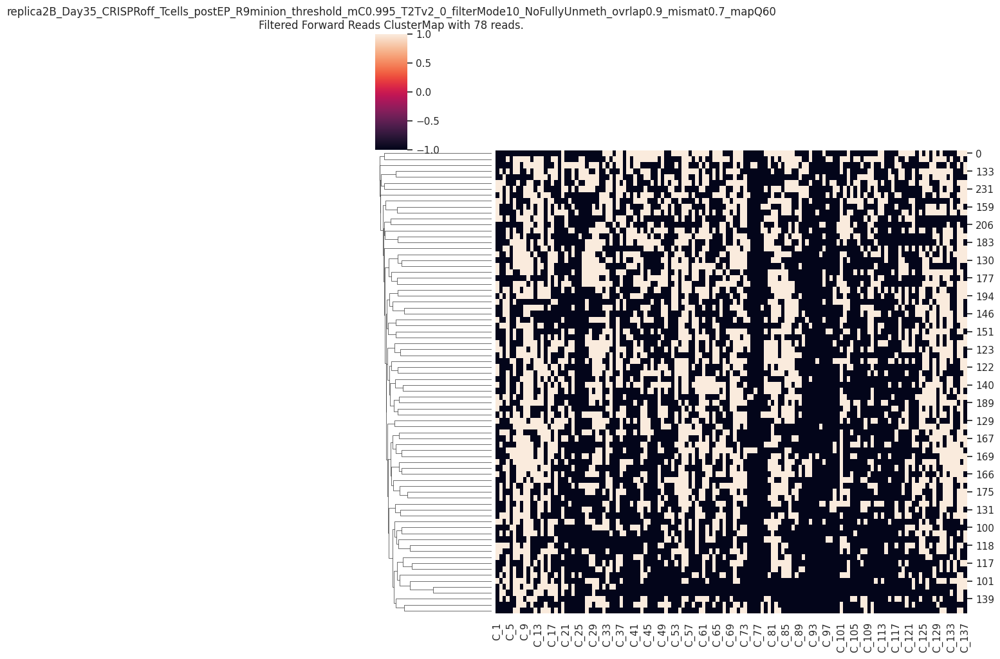

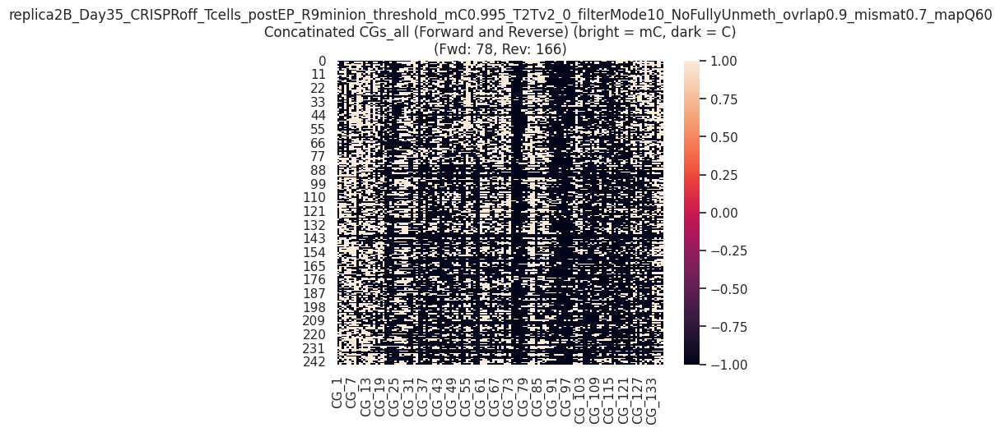

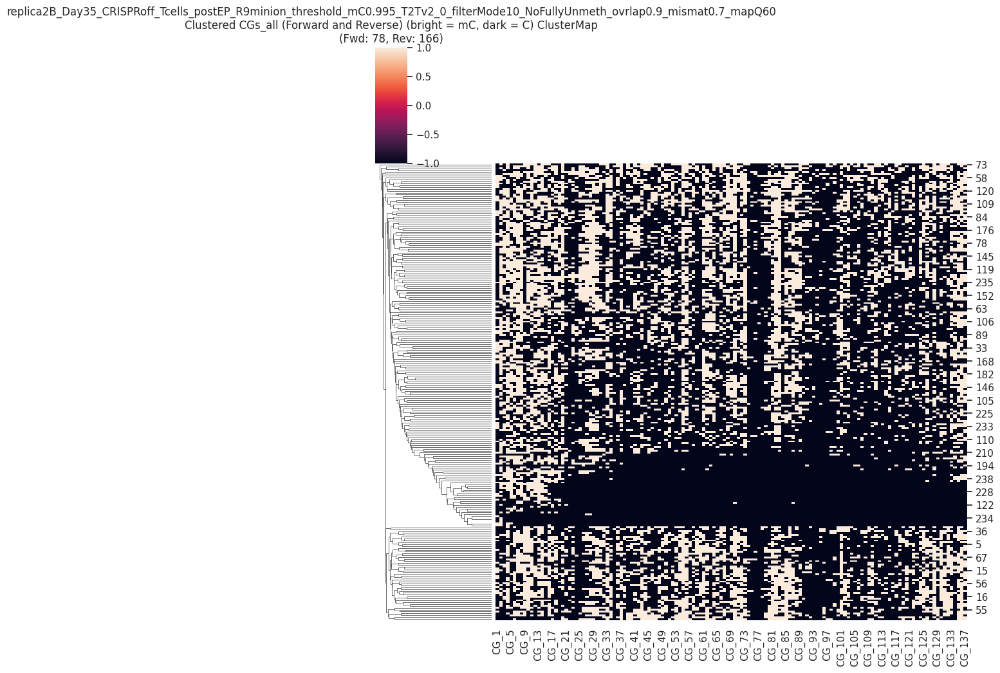

CGs_all saved as CG_137_padded_reads_replica2B_Day35_CRISPRoff_Tcells_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60_mCthresh0.995_T2Tv2_0_chr1:206583354-206589854_2025-11-10_units_combined_numFWD78_numRVS166.npy in dimelo_v2_output
Pipeline executed successfully (analize_forward_reverse_CGs_pipeline function)


In [13]:
threshold_mC = 0.995 #0.7 #  0.9 #0.99

threshold_mode_base_qualities=10
threshold_mapping_qualities=60 
# threshold_avg_base_qualities=20

threshold_fraction_overlap_aligned = 0.9 # 0.1
threshold_fraction_mismatches = 0.7 # 0.5
# indel_fraction_threshold = 1  # 0.8
# non_fraction_threshold   = 1
max_reads_plot = 3000
remove_reads_that_dont_fully_cover_region=True

# experiment_name = "day"+str(day_num)+"_unedited_Tcells_Thr"+str(threshold_mC)+"_NoFullyUnmethylated_T2Tv2"
experiment_name = f'{experiment_condition}_threshold_mC{threshold_mC}_{reg_genome_version}' + \
    "_filterMode" + str(threshold_mode_base_qualities) + \
    "_NoFullyUnmeth_ovrlap"+str(threshold_fraction_overlap_aligned)+"_mismat"+str(threshold_fraction_mismatches)+"_mapQ"+str(threshold_mapping_qualities)
# +"_avgBaseQ"+str(threshold_avg_base_qualities)

bam_path = original_bam_path #  unedit_bam_path

print('experiment_name = ', experiment_name)

save_padded_reads_name_np = f"padded_reads_{experiment_name}_mCthresh{threshold_mC}_{reg_genome_version}_{region_str}_{date_today}.npy"
output_dir = create_output_directory("./dimelo_v2_output")

extract_file, extract_regions = extract_from_bam(
    experiment_name = experiment_name,
    bam_path=bam_path,
    ref_genome_file=ref_genome_path,
    output_dir=output_dir,
    region=region_str,
    motifs=motifs,
    output_name='extracted_reads',
    threshold_mC=threshold_mC,
)
keep_full_coverage_reads_only=True

if extract_file:
    reads_df, regions_dict = process_extracted_reads(extract_file, bam_path, region_str, 
        motifs, ref_seq_list, ref_genome_path=ref_genome_path, 
        experiment_name=experiment_name, output_dir=output_dir, 
        keep_full_coverage_reads_only=keep_full_coverage_reads_only,
        threshold_fraction_overlap_aligned=threshold_fraction_overlap_aligned,
        threshold_fraction_mismatches=threshold_fraction_mismatches,
        threshold_mapping_qualities=threshold_mapping_qualities, 
        threshold_mode_base_qualities=threshold_mode_base_qualities,
        max_reads_plot=max_reads_plot,
        remove_reads_that_dont_fully_cover_region=remove_reads_that_dont_fully_cover_region)
        # threshold_avg_base_qualities=threshold_avg_base_qualities,
        # indel_fraction_threshold=indel_fraction_threshold, 
        # non_fraction_threshold=non_fraction_threshold)
        
    visualize_data(reads_df)

    padded_reads = create_padded_reads(reads_df, regions_dict, region_length)
    if padded_reads is not None:
        plot_padded_reads(padded_reads, ref_seq_list)
        save_padded_reads(padded_reads, output_dir, save_padded_reads_name_np)

# Processing and visualizing CpG units on forward and reverse strands 
try: 

    # Process pipeline
    CGs_all, C_fwd_df, G_revs_df, padded_reads_df, CG_pair_idx, CG_coordinates, CG_info_df = analize_forward_reverse_CGs_pipeline(
        experiment_name=experiment_name, save_folder_path=output_dir, 
        save_padded_reads_name_np=save_padded_reads_name_np, 
        ref_genome_file=ref_genome_path, region_chr=region_chr, region_start=region_start, region_end=region_end
    )

    print("Pipeline executed successfully (analize_forward_reverse_CGs_pipeline function)")
    # return CGs_all, C_fwd_df, G_revs_df, padded_reads_df

except Exception as e:
    print(f"Error in main pipeline (analize_forward_reverse_CGs_pipeline function): {e}")


experiment_name =  Tcells_CRISPRoff_Day35_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60
Region length: 6500
No specified number of cores requested. 24 available on machine, allocating all.
Modification threshold of 0.995 will be treated as coming from range 0-1.


          | Step 1: Identify motif locations in up_chm13v2.0.fasta   0% | 00:00

          | Step 2: Parse regions in sort_align_t2t_v2_0_trim_20250908_Day35_CROFF_Tcells_2Libraries_Minion_R9…

          |    0%

          | Transferring 510 from reads.CG,0.txt into reads.combined_basemods.h5, new size 510   0% | 00:00<?

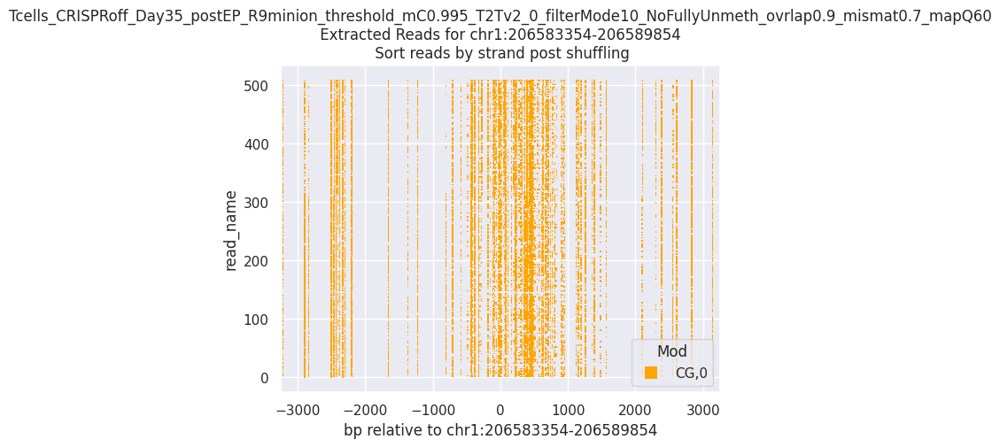

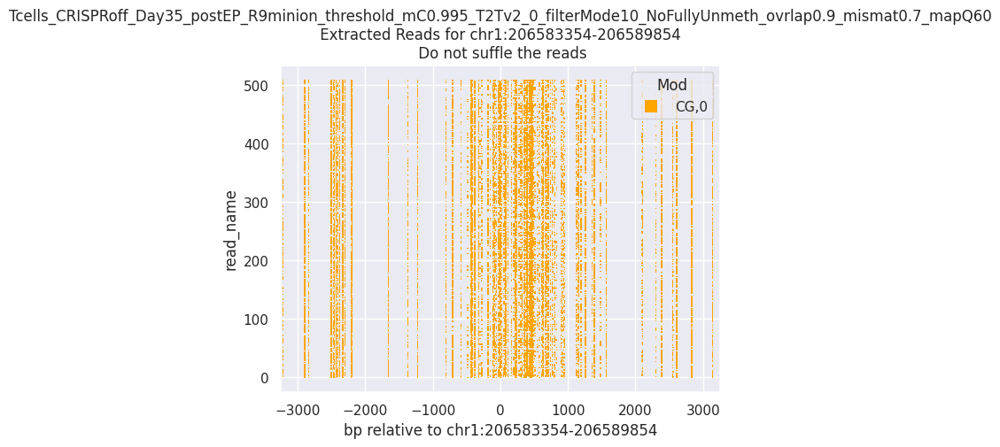

Found read coordinates: 510 reads
Unique read names with methylation: 506
In function count_indels_and_mismatches: Processing region is chr1:206583354-206589854
In function count_indels_and_mismatches: Region length is 6500
Found 356 reads with full coverage
Reads with methylation data: 506
Overlap between full coverage and methylation: 355
After full coverage filtering: 355 reads with methylation data
Subset BAM written to: dimelo_v2_output/pre_filtered_ROI_reads_Tcells_CRISPRoff_Day35_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam
Index written to: dimelo_v2_output/pre_filtered_ROI_reads_Tcells_CRISPRoff_Day35_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam.bai
Pre Filtered BAM with reads that have some covarage of the ROI written to 
 pre_filtered_ROI_reads_Tcells_CRISPRoff_Day35_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam


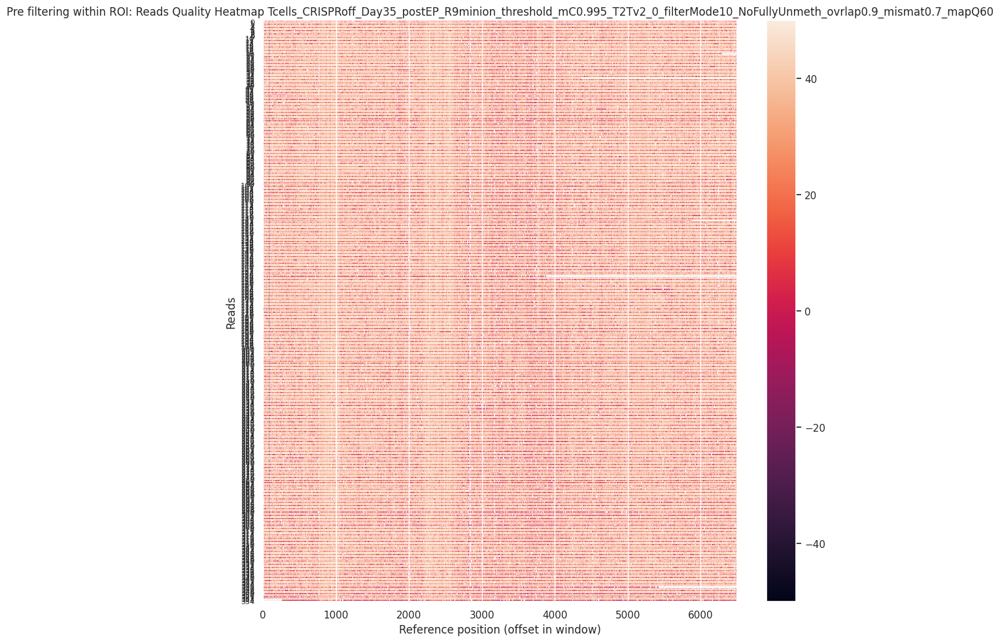

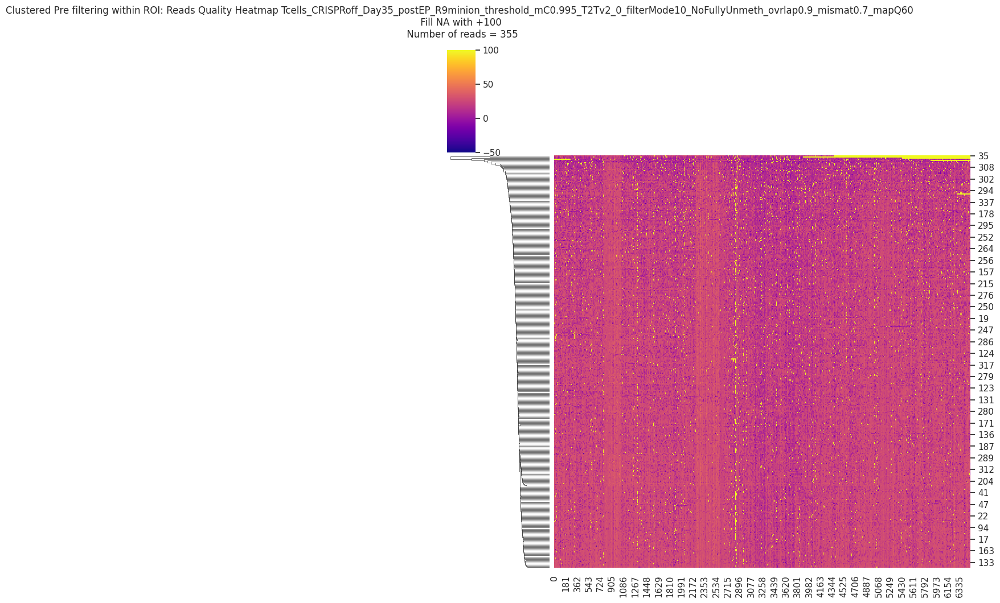

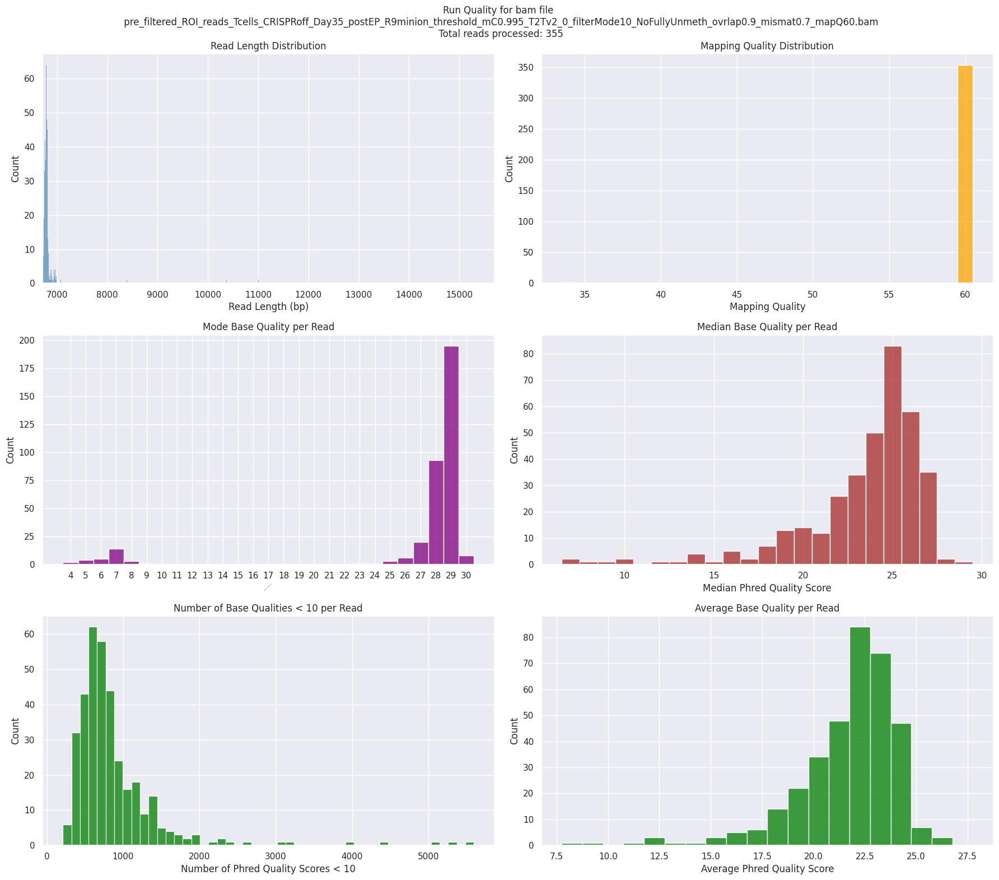

Total reads processed: 355
After removing reads with <90.0% threshold_fraction_overlap_aligned: 350 reads with methylation data
After removing reads with >70.0% threshold_fraction_mismatches: 350 reads with methylation data
After removing reads with >60 threshold_mapping_qualities: 349 reads with methylation data
After removing reads with >10 threshold_mode_base_qualities: 326 reads with methylation data
Final result: 15164 reads with methylation information out of 510 total reads
Subset BAM written to: dimelo_v2_output/filtered_reads_overlap_MORE_than_0.9_Tcells_CRISPRoff_Day35_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam
Index written to: dimelo_v2_output/filtered_reads_overlap_MORE_than_0.9_Tcells_CRISPRoff_Day35_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60.bam.bai
Filtered BAM with reads that have mC and base overlap > 0.9 written to 
 dimelo_v2_output/filtered_reads_overlap_MO

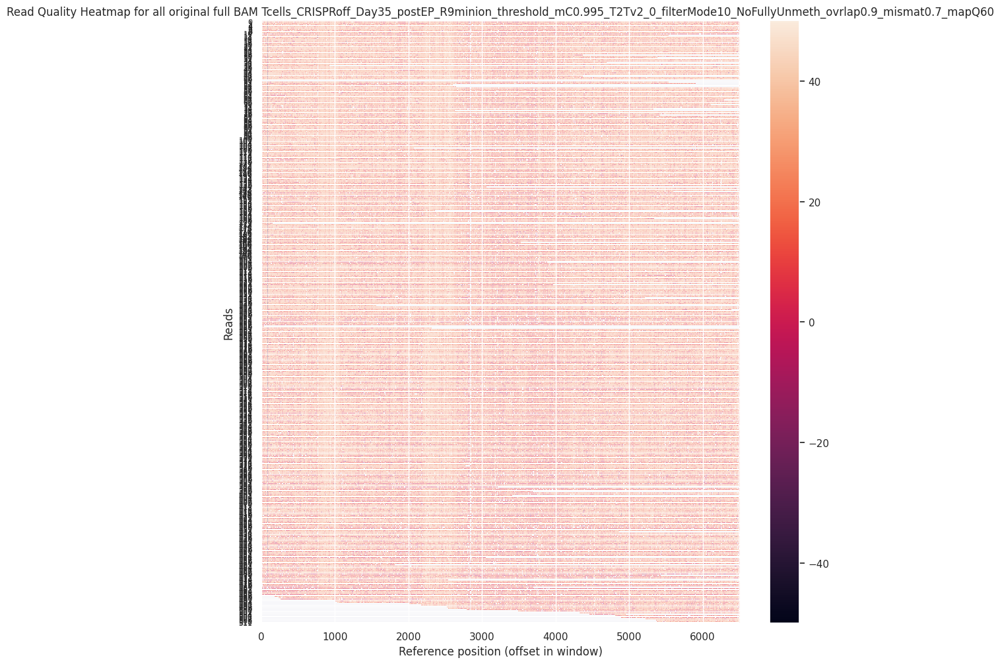

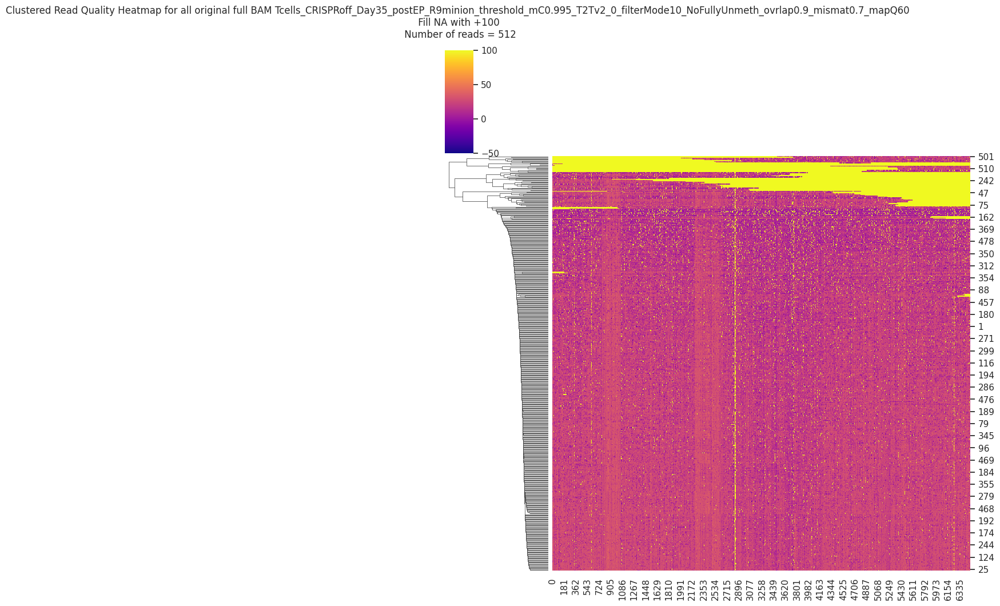

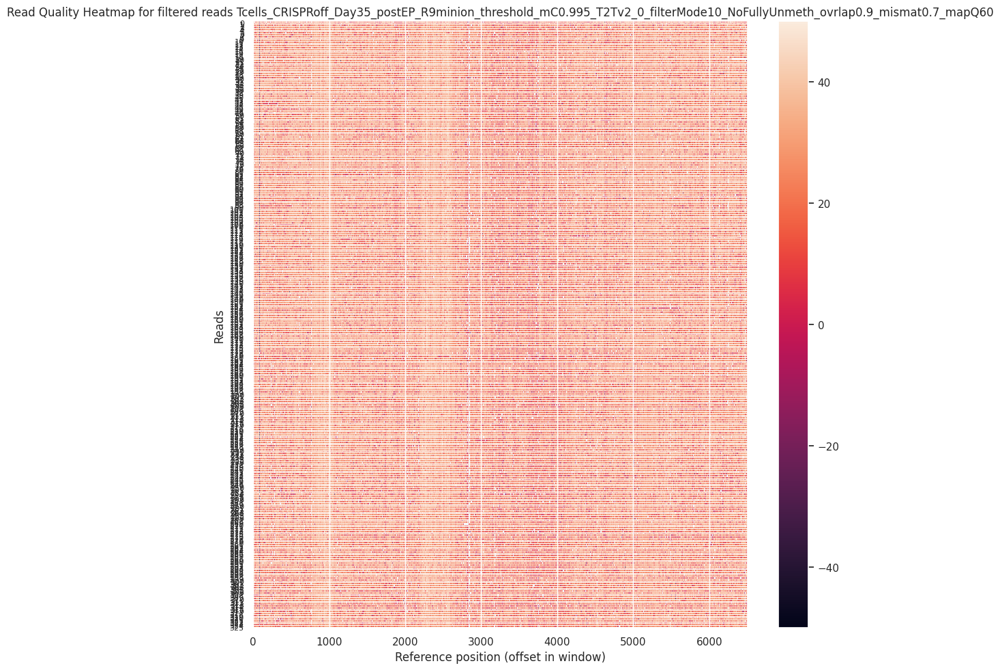

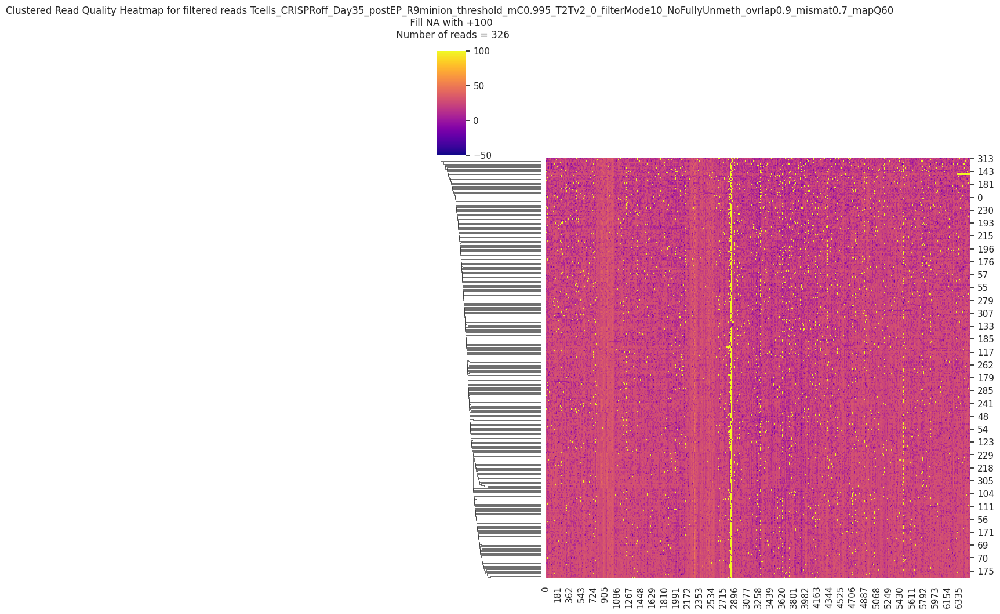

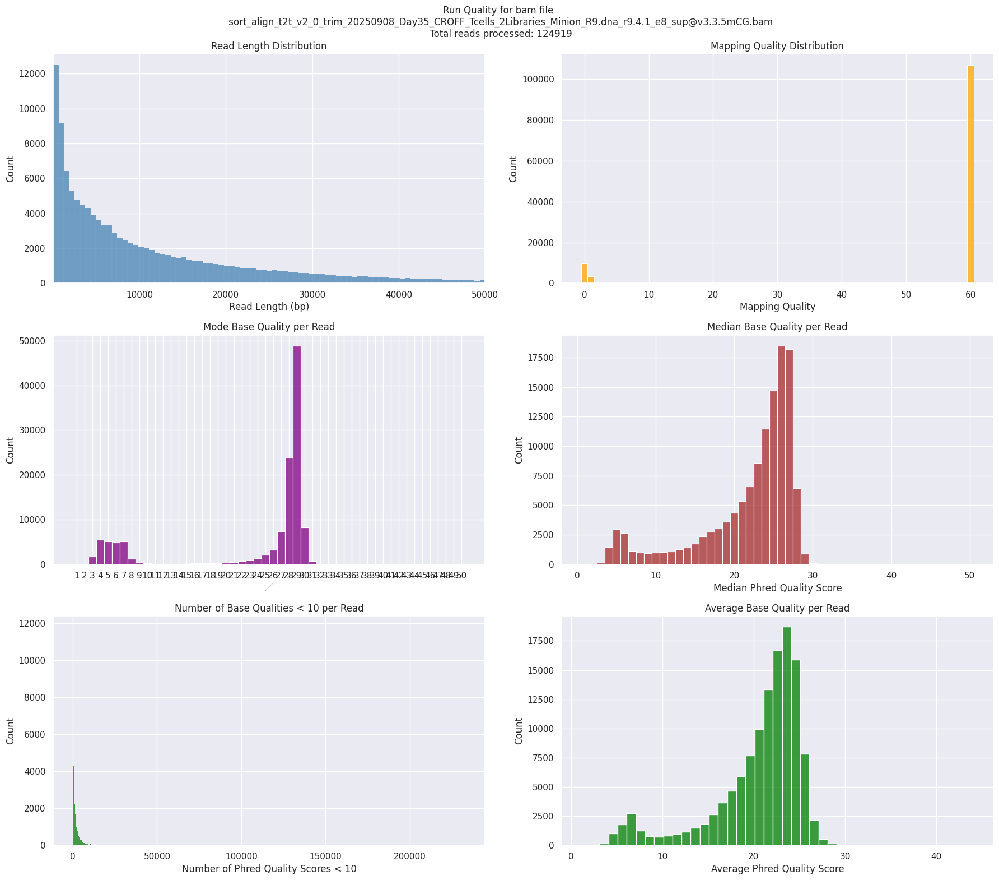

Total reads processed: 124919


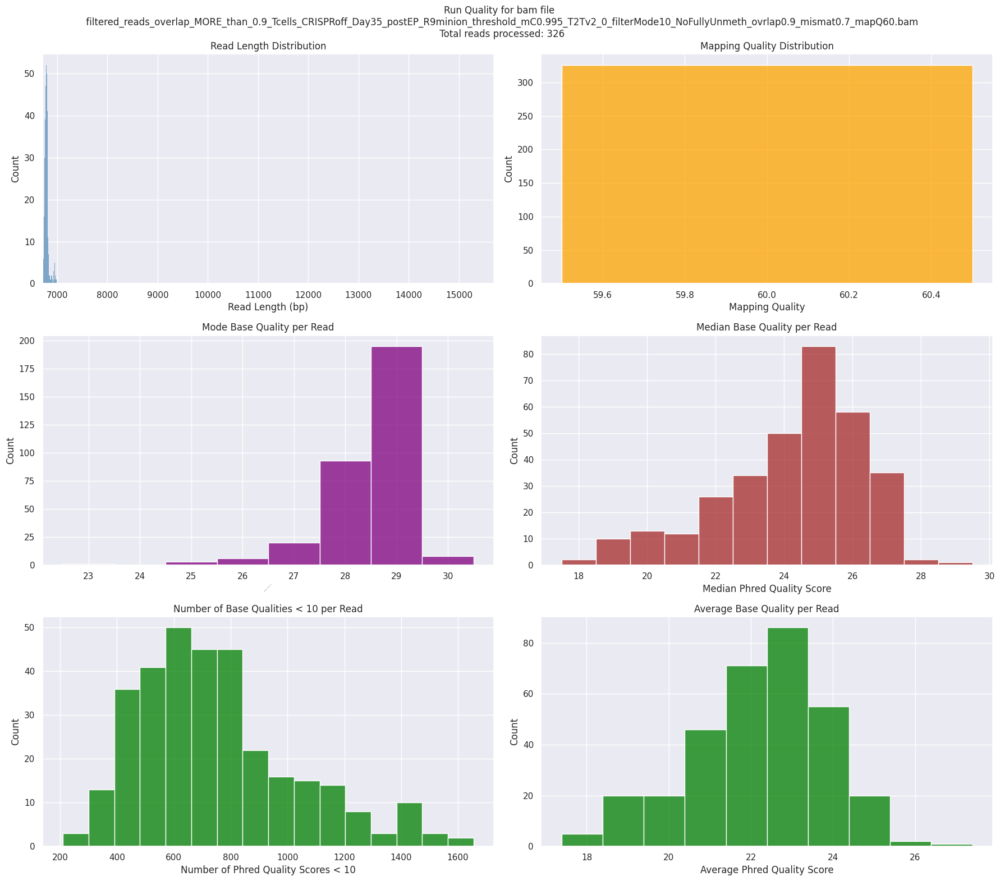

Total reads processed: 326


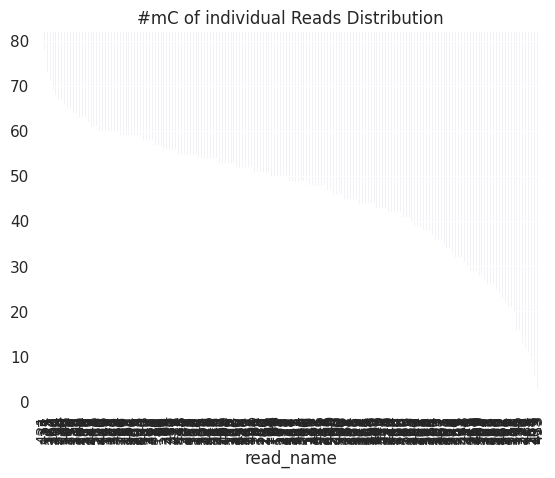

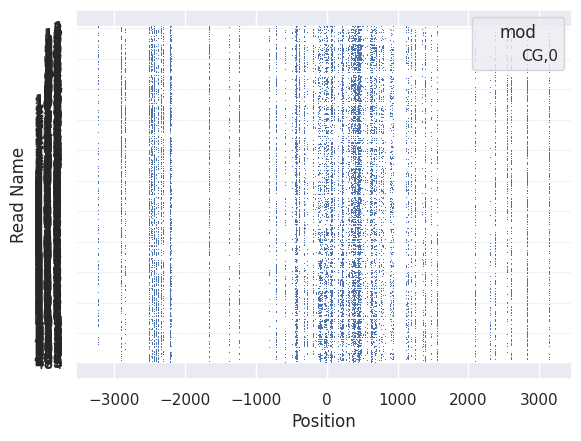

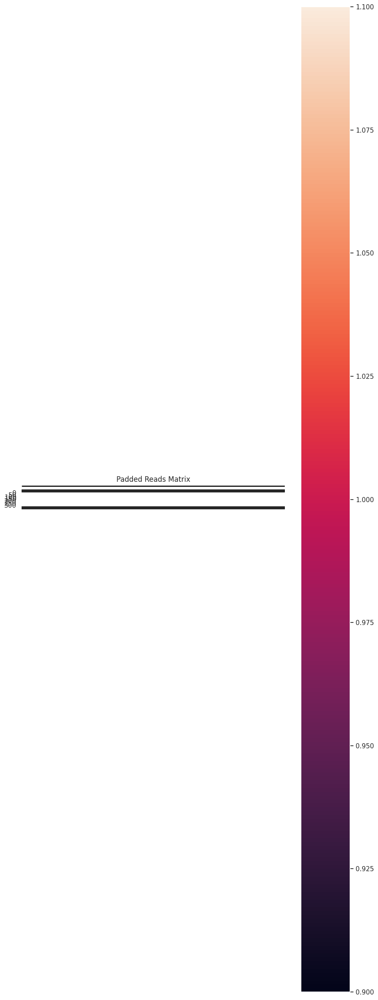

Padded reads saved to padded_reads_Tcells_CRISPRoff_Day35_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60_mCthresh0.995_T2Tv2_0_chr1:206583354-206589854_2025-11-09.npy
Padded reads loaded successfully.


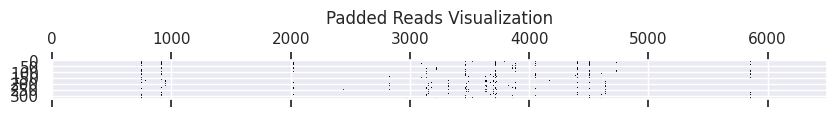

Visualization completed.
Region length: 6500
GTCATTGTATGGTTCCTGGGATAAGAGTAAGAACCGTGGTCCCTTGCTCTGTCAAAATCATAAACCTATTTTCTTTGTATTTTGACTTAATTACATAAGCTTGTTTTGGATTGGAAGGTCTATAGAGACTATTTTAGTGCCAAATGCTATTTAATCAATGCAGAAATAAGCCCTTGAGAGGTGCAGTGACTCAGCTGAGGACACACTGATAGTTTCTGGTAGATAAGTATGAAGCCTTGGAACTACTTCTCATATCATAAGCCCCTGGGTTCCCAAATCACCTCCCCAAGTACCTAATTCATCATCCTCTGCATACAAGAAATTTTTGCTCATTCCAATAAAAAGAATGTAGTACGGCAGGACAGGAGAAGTACAGGTTTTGGAATCAAACTAGGTTTAGATTCTGACCTGGTCGCTAGTTAGTGCATGGGCTTTGGTAAACAGCCTCTCAGCCTGTTTCCTTGTCTGCAAAATATGGATAGTTATCTTCACTTCATGAAGTTGTGTTGGTGAAATGGTATAATGTGTATAAAGCAACTGGAACACAACAAATGAGGCCATTTATTTAAAATAATCTTTAGTAAGTTATAAATTCACATATTTGCTTTTTTCTGAGGAATGCTTAGATTTTATCATAGATCTCTTTTCTAAATTGAGTAAATACATAGTGGATTTCTTTGTTTCCTTCCCCTCAGAATGTTGAAATTTGGCTGATTGTAACTATTACTTAAGACTCTATCCAGTAATTGTTCGTAAAATTTCTTTTCTTTTTTTTTTTTTGAGACGGAGTTTTGCTCTCGTCCCCCAGGCTGGAGTGCAATGGCGCGATCTTGGCTCACTGCAACCTCCGCCTCCCAGGTTCAAGTGATTCTCCCGCCTCAGCCTCCCAAGTAGCTGGGATTACAGGCACCTGCCACAACGCCCAGCCAATTTTTGTATTTTTAGTAGAGACGGG

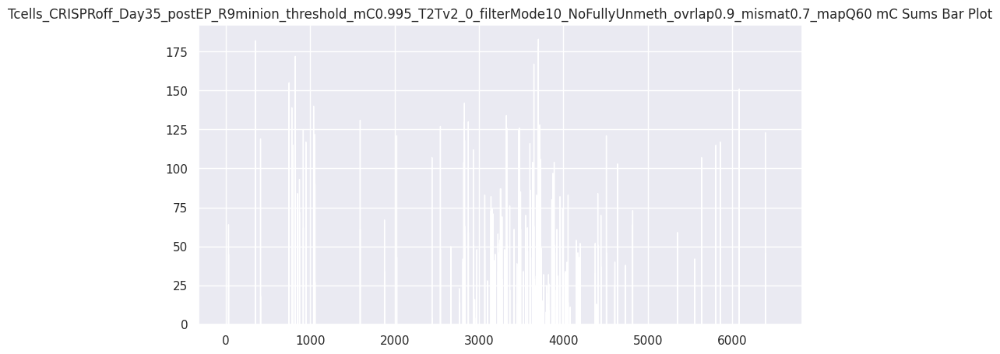

(mC_sums / len(CGs_all) = [0. 0. 0. ... 0. 0. 0.]


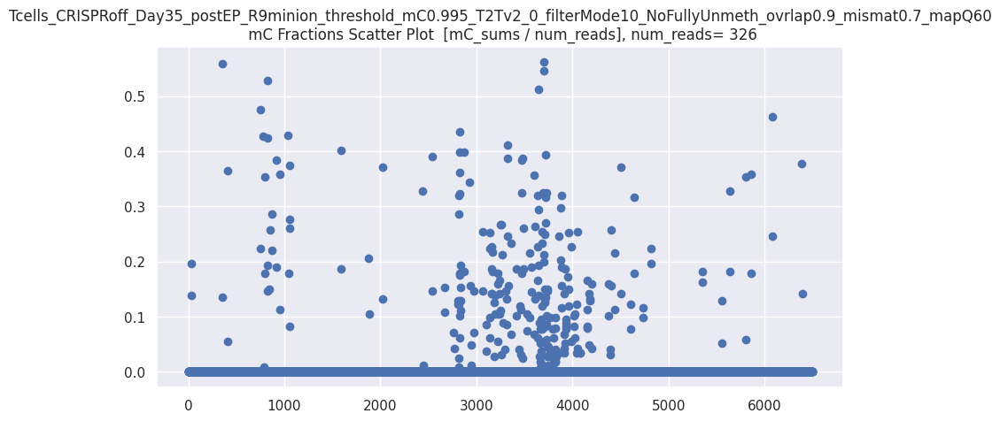

len(CGs_all) = 326
CGs_all.shape = (326, 137)
len(CGs_all_on_fwd_C_sums) = 6500
CGs_all_on_fwd_C_sums.shape = (6500,)


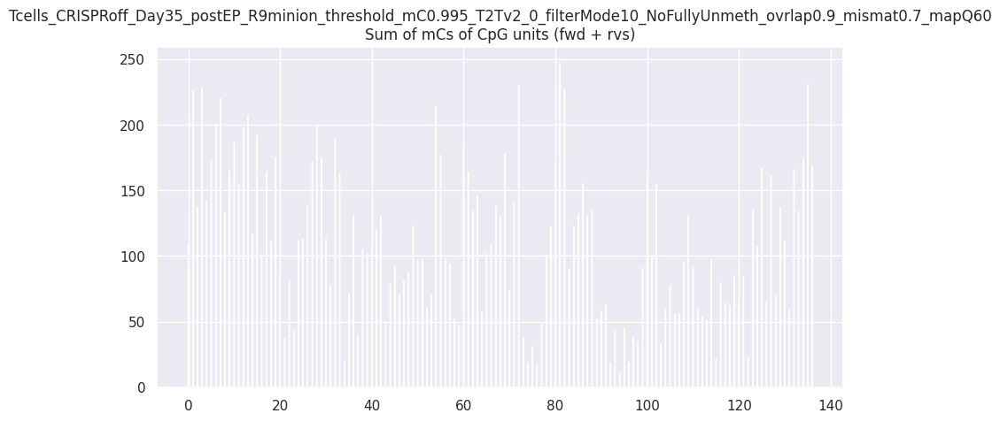

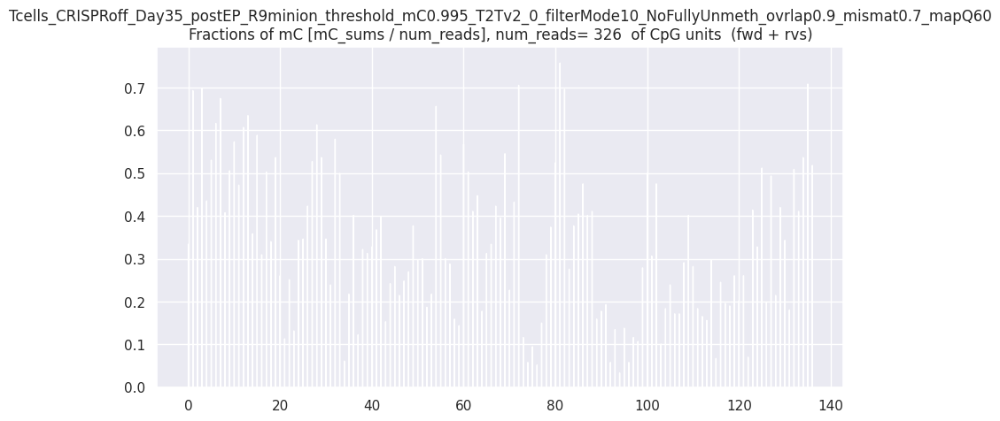

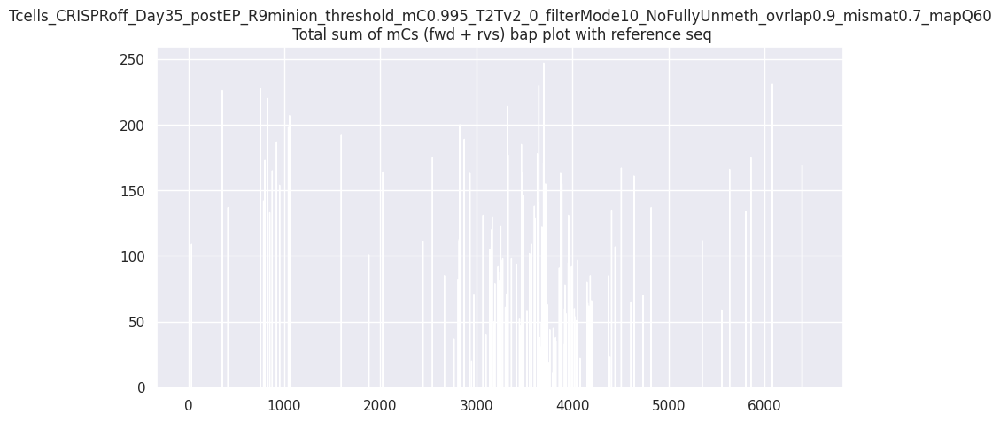

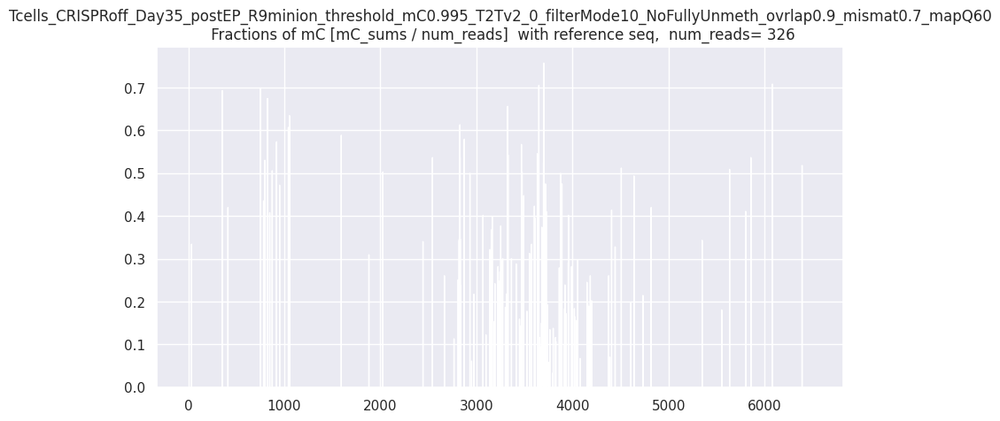

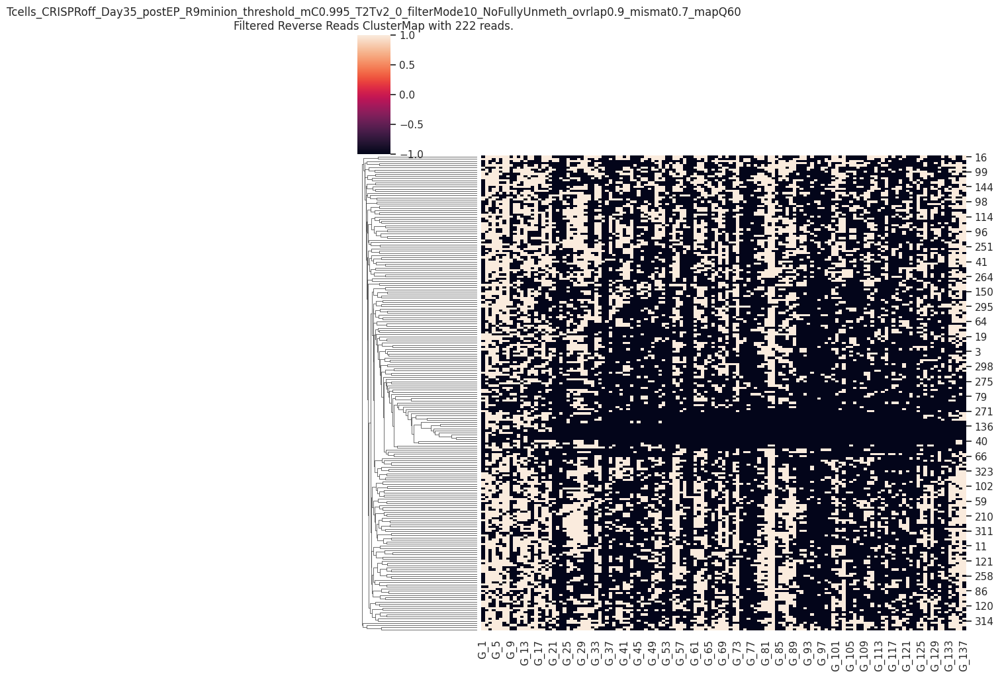

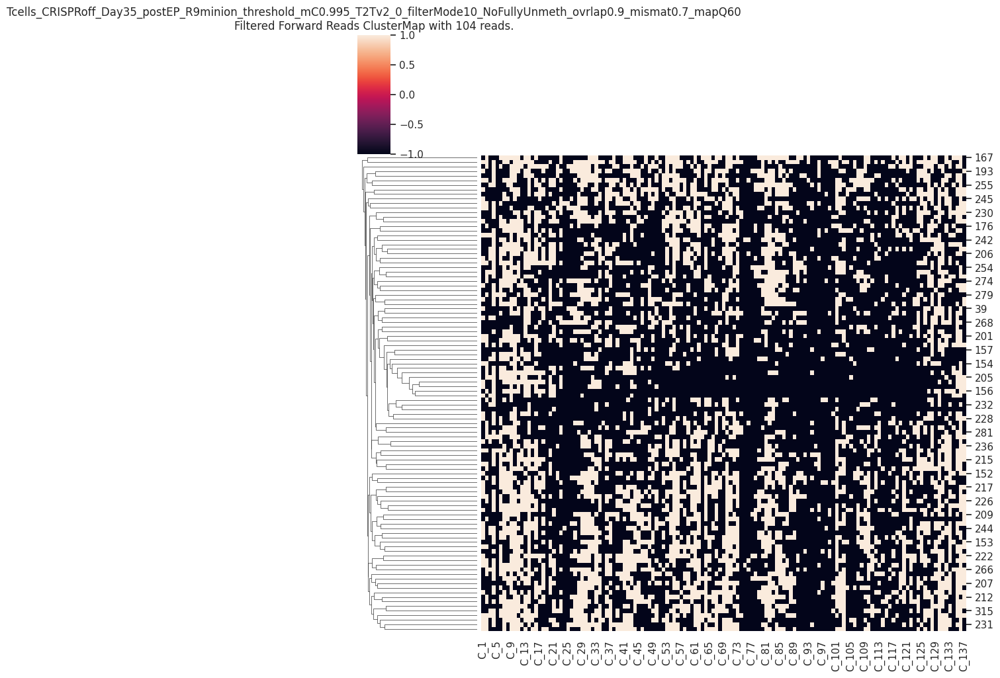

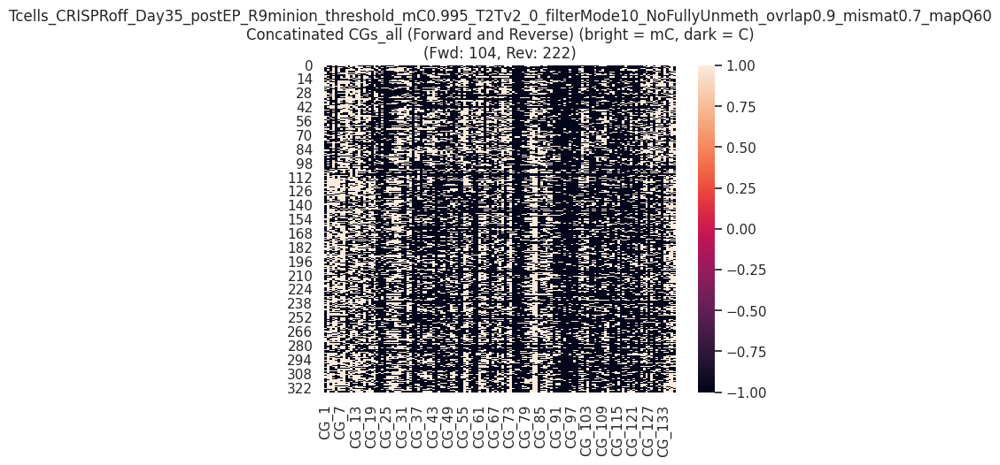

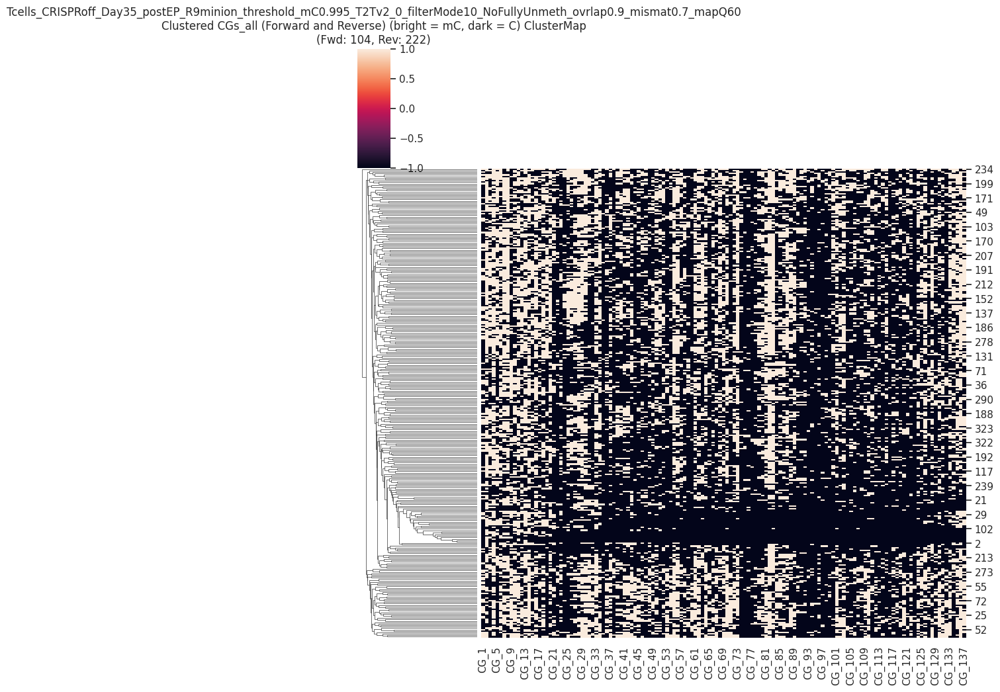

CGs_all saved as CG_137_padded_reads_Tcells_CRISPRoff_Day35_postEP_R9minion_threshold_mC0.995_T2Tv2_0_filterMode10_NoFullyUnmeth_ovrlap0.9_mismat0.7_mapQ60_mCthresh0.995_T2Tv2_0_chr1:206583354-206589854_2025-11-09_units_combined_numFWD104_numRVS222.npy in dimelo_v2_output
Pipeline executed successfully (analize_forward_reverse_CGs_pipeline function)


In [ ]:
# threshold_mC = 0.995 #0.7 #  0.9 #0.99

# threshold_mode_base_qualities=10
# threshold_mapping_qualities=60 
# # threshold_avg_base_qualities=20

# threshold_fraction_overlap_aligned = 0.9 # 0.1
# threshold_fraction_mismatches = 0.7 # 0.5
# # indel_fraction_threshold = 1  # 0.8
# # non_fraction_threshold   = 1
# max_reads_plot = 3000
# remove_reads_that_dont_fully_cover_region=True

# # experiment_name = "day"+str(day_num)+"_unedited_Tcells_Thr"+str(threshold_mC)+"_NoFullyUnmethylated_T2Tv2"
# experiment_name = f'{experiment_condition}_threshold_mC{threshold_mC}_{reg_genome_version}' + \
#     "_filterMode" + str(threshold_mode_base_qualities) + \
#     "_NoFullyUnmeth_ovrlap"+str(threshold_fraction_overlap_aligned)+"_mismat"+str(threshold_fraction_mismatches)+"_mapQ"+str(threshold_mapping_qualities)
# # +"_avgBaseQ"+str(threshold_avg_base_qualities)

# bam_path = original_bam_path #  unedit_bam_path

# print('experiment_name = ', experiment_name)

# save_padded_reads_name_np = f"padded_reads_{experiment_name}_mCthresh{threshold_mC}_{reg_genome_version}_{region_str}_{date_today}.npy"
# output_dir = create_output_directory("./dimelo_v2_output")

# extract_file, extract_regions = extract_from_bam(
#     experiment_name = experiment_name,
#     bam_path=bam_path,
#     ref_genome_file=ref_genome_path,
#     output_dir=output_dir,
#     region=region_str,
#     motifs=motifs,
#     output_name='extracted_reads',
#     threshold_mC=threshold_mC,
# )
# keep_full_coverage_reads_only=True

# if extract_file:
#     reads_df, regions_dict = process_extracted_reads(extract_file, bam_path, region_str, 
#         motifs, ref_seq_list, ref_genome_path=ref_genome_path, 
#         experiment_name=experiment_name, output_dir=output_dir, 
#         keep_full_coverage_reads_only=keep_full_coverage_reads_only,
#         threshold_fraction_overlap_aligned=threshold_fraction_overlap_aligned,
#         threshold_fraction_mismatches=threshold_fraction_mismatches,
#         threshold_mapping_qualities=threshold_mapping_qualities, 
#         threshold_mode_base_qualities=threshold_mode_base_qualities,
#         max_reads_plot=max_reads_plot,
#         remove_reads_that_dont_fully_cover_region=remove_reads_that_dont_fully_cover_region)
#         # threshold_avg_base_qualities=threshold_avg_base_qualities,
#         # indel_fraction_threshold=indel_fraction_threshold, 
#         # non_fraction_threshold=non_fraction_threshold)
        
#     visualize_data(reads_df)

#     padded_reads = create_padded_reads(reads_df, regions_dict, region_length)
#     if padded_reads is not None:
#         plot_padded_reads(padded_reads, ref_seq_list)
#         save_padded_reads(padded_reads, output_dir, save_padded_reads_name_np)

# # Processing and visualizing CpG units on forward and reverse strands 
# try: 

#     # Process pipeline
#     CGs_all, C_fwd_df, G_revs_df, padded_reads_df, CG_pair_idx, CG_coordinates, CG_info_df = analize_forward_reverse_CGs_pipeline(
#         experiment_name=experiment_name, save_folder_path=output_dir, 
#         save_padded_reads_name_np=save_padded_reads_name_np, 
#         ref_genome_file=ref_genome_path, region_chr=region_chr, region_start=region_start, region_end=region_end
#     )

#     print("Pipeline executed successfully (analize_forward_reverse_CGs_pipeline function)")
#     # return CGs_all, C_fwd_df, G_revs_df, padded_reads_df

# except Exception as e:
#     print(f"Error in main pipeline (analize_forward_reverse_CGs_pipeline function): {e}")
